# I. Importing Libraries
> [Dataset Link](https://defined.ai/datasets/tagalog-spontaneous-dialogue)

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
from sklearn.utils.class_weight import compute_class_weight

import os
import re
import time
import json
from json import JSONDecodeError
from dotenv import load_dotenv
from collections import Counter
from websockets.exceptions import ConnectionClosedError
from tqdm.notebook import tqdm
from IPython.display import HTML, display, Markdown, Audio # type: ignore
from pydub import AudioSegment
from pprint import pformat
# conda install -c conda-forge ffmpeg

# conda ins
from google import genai
from google.genai import types

import torch
import torch.nn as nn
from transformers import (
    XLMRobertaTokenizer, XLMRobertaForSequenceClassification,
    Trainer, TrainingArguments, EarlyStoppingCallback # type: ignore
)

# II. Setup and Helper Functions

In [2]:
CREATE_SYNTHETIC = False
USE_GEMINI = False

In [3]:
BANKING_PATH = 'audio_samples/banking'
INSURANCE_PATH = "audio_samples/insurance"
RETAIL_PATH = "audio_samples/retail"
TELECOM_PATH = "audio_samples/telecom"

RANDOM_SEED = 42
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Set the random seed for reproducibility
torch.manual_seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)

# Check if GPU is available
print(f"Using device: {DEVICE}")

# Google API: Configure on your own
load_dotenv(dotenv_path='../.env')
GOOGLE_API_KEY = os.getenv('GOOGLE_API_KEY')
if GOOGLE_API_KEY is None:
  print("Please set the GOOGLE_API_KEY environment variable.")
else:
  print("Google API key loaded successfully.")

Using device: cpu
Google API key loaded successfully.


In [4]:
def load_dataset_quality(json_path: str) -> pd.DataFrame:
    """
    Loads the given JSON, flattens it, and returns a tidy DataFrame with:
      - Field      : original flattened key
      - RawValue   : original value (could be a list, str, number, etc.)
      - Count      : first element if RawValue is [count, percent], else NaN
      - Percent    : second element if RawValue is [count, percent], else NaN
      - DurationSec: numeric seconds if Field contains “Duration”, else NaN
    """
    # 1) Load & normalize
    with open(json_path, 'r', encoding='utf-8') as f:
        data = json.load(f)
    df = pd.json_normalize(data, sep='_')

    # 2) Melt into Field/RawValue
    df_melt = df.melt(var_name='Field', value_name='RawValue')

    # 3) Split count & percent
    def split_list(x):
        return x if isinstance(x, list) and len(x) == 2 else [pd.NA, pd.NA]
    df_melt[['Count','Percent']] = pd.DataFrame(
        df_melt['RawValue'].apply(split_list).tolist(), 
        index=df_melt.index
    )

    # 4) Parse durations
    mask = df_melt['Field'].str.contains('Duration', case=False)
    df_melt.loc[mask, 'DurationSec'] = (
        pd.to_timedelta(df_melt.loc[mask, 'RawValue']).dt.total_seconds()
    )

    # 5) Select and return
    return df_melt[['Field','RawValue','Count','Percent','DurationSec']].reset_index(drop=True)

In [5]:
def display_df(df: pd.DataFrame):
    html = df.head(300).to_html(index=False)

    scrollable = f'''
    <div style="
        max-height: 300px;
        max-width: 100%;
        overflow: auto;
        border: 1px solid #ccc;
        white-space: nowrap;
    ">
        {html}
    </div>
    '''

    display(HTML(scrollable))

In [6]:
def get_audio_and_path(df, idx, base_path, sliced=False):
    # grab the relative path from the DataFrame
    if sliced and 'AudioFile' in df.columns:
        rel_path = df.at[idx, 'AudioFile']
    else:
        rel_path = df.at[idx, 'RelativeFileName'] if 'RelativeFileName' in df.columns else df.at[idx, 'RelativeFileName']
    # build the absolute path
    full_path = os.path.join(base_path, rel_path)
    # create the Audio player
    audio_player = Audio(full_path)
    return audio_player, full_path

In [7]:
def process_and_slice_transcripts(df: pd.DataFrame, base_path: str, out_folder: str = "sliced_audio") -> pd.DataFrame:
    """
    Processes and slices transcripts more efficiently by:
      1. Working on a copy of the DataFrame to avoid mutating the original.
      2. Vectorizing speaker metadata assignment based on Channel.
      3. Iterating ONLY once to slice audio segments if not already done.
      4. Dropping timing and channel-specific columns, adding:
         - AudioFile: relative path to the sliced WAV file.
         - SpeakerId, Native, Role, Age, Gender, LivingCountry, Accent.
    """
    # 1) Copy DataFrame
    df_new = df.copy()

    # 2) Vectorized speaker metadata
    left_mask = df_new['Channel'] == 1
    right_mask = ~left_mask
    df_new['SpeakerId']      = np.where(left_mask, df_new['LeftChannelSpeakerId'], df_new['RightChannelSpeakerId'])
    df_new['IsNative']         = np.where(left_mask, df_new['LeftChannelNative'], df_new['RightChannelNative'])
    df_new['Role']           = np.where(left_mask, df_new['LeftChannelRole'], df_new['RightChannelRole'])
    df_new['Age']            = np.where(left_mask, df_new['LeftChannelSpeakerAge'], df_new['RightChannelSpeakerAge'])
    df_new['Gender']         = np.where(left_mask, df_new['LeftChannelSpeakerGender'], df_new['RightChannelSpeakerGender'])
    df_new['Country']  = np.where(left_mask, df_new['LeftChannelSpeakerLivingCountry'], df_new['RightChannelSpeakerLivingCountry'])
    df_new['Accent']         = np.where(left_mask, df_new['LeftChannelSpeakerAccent'], df_new['RightChannelSpeakerAccent'])

    # Prepare output folder
    folder_path = os.path.join(base_path, out_folder)
    os.makedirs(folder_path, exist_ok=True)

    # Helper to convert HH:MM:SS.sss to ms
    def time_to_ms(t: str) -> int:
        h, m, s = t.split(':')
        total = int(h)*3600 + int(m)*60 + float(s)
        return int(total * 1000)

    # 3) Slice audio and assign new file path
    rel_paths = []
    for idx, row in df_new.iterrows():
        out_name = f"{row['Domain']}_{row['TranscriptionId']}.wav"
        rel_path = out_folder + "/" + out_name
        abs_path = os.path.join(base_path, rel_path)
        if not os.path.exists(abs_path):
            audio = AudioSegment.from_file(os.path.join(base_path, row['RelativeFileName']))
            clip = audio[time_to_ms(row['StartTime']): time_to_ms(row['EndTime'])]
            clip.export(abs_path, format='wav')
        rel_paths.append(rel_path)
    df_new['AudioFile'] = rel_paths

    # 4) Drop old columns
    drop_cols = [
        # 'StartTime','EndTime',
        'Channels','Channel',
        'LeftChannelSpeakerId','LeftChannelNative','LeftChannelRole','LeftChannelSpeakerAge',
        'LeftChannelSpeakerGender','LeftChannelSpeakerLivingCountry','LeftChannelSpeakerAccent',
        'RightChannelSpeakerId','RightChannelNative','RightChannelRole','RightChannelSpeakerAge',
        'RightChannelSpeakerGender','RightChannelSpeakerLivingCountry','RightChannelSpeakerAccent'
    ]
    df_final = df_new.drop(columns=drop_cols)

    return df_final

In [8]:
async def handle_response(stream, print_process=False, display_output=False):
    """Stream output from the session.
    """
    all_responses = []
    text_lines = []

    async for msg in stream.receive():
        all_responses.append(msg)

        if text := msg.text:
            # When a text message is received.
            header = "### Text"
            # Display header if this is the first text chunk.
            if len(all_responses) < 2 or not all_responses[-2].text:
                if print_process:
                    display(Markdown(header))
                text_lines.append(header)

            if print_process:
                print(text, end='')
            text_lines.append(text)

        elif msg.server_content and msg.server_content.model_turn:
            # Handle model turn: display generated code, execution results, or inline images.
            for part in msg.server_content.model_turn.parts:
                if code := part.executable_code:
                    code_str = f"### Code\n```\n{code.code}\n```"
                    if print_process:
                        display(Markdown(code_str))
                elif result := part.code_execution_result:
                    result_str = (
                        f"### Result: `{result.outcome}`\n"
                        f"```\n{pformat(result.output)}\n```"
                    )
                    if print_process:
                        display(Markdown(result_str))
                elif img := part.inline_data:
                    if print_process:
                        display(Image(img.data))

    # When print_process is False, process the accumulated lines:
    if not print_process:
        combined_text = "\n".join(text_lines).strip()
        # Find the index of the last occurrence of the "### Text" header.
        marker = "### Text"
        last_marker_index = -1
        for i, line in enumerate(text_lines):
            if line.strip().startswith(marker):
                last_marker_index = i
        if last_marker_index != -1 and last_marker_index + 1 < len(text_lines):
            final_output = "\n".join(text_lines[last_marker_index + 1:]).strip()
        else:
            final_output = combined_text
        
        if display_output:
            display(Markdown(final_output))

    return all_responses, final_output

In [9]:
def sanitize_json(raw: str) -> str:
    # strip fences
    text = raw.strip()
    if text.startswith("```"):
        lines = text.splitlines()
        text = "\n".join(lines[1:-1])
    # 1) split into lines and strip whitespace
    lines = text.splitlines()
    stripped = [ln.strip() for ln in lines if ln.strip()]
    # 2) join them back together
    compact = "".join(stripped)
    # 3) collapse any accidental spaces around punctuation
    compact = re.sub(r'\s*([,:{}\[\]])\s*', r'\1', compact)
    return compact

In [10]:
def finalize_df(df : pd.DataFrame) -> pd.DataFrame: 
    new_df = df.copy()
    new_df = new_df.rename(columns={
        "TranscriptionId": "case_id",
        "Transcription": "case_text",
        "RelativeFileName": "MainAudioFile"
    })
    new_df['case_type'] = new_df['case_type'].replace('CreditCards', 'Credit Cards')
    new_df = new_df.drop(columns=['StartTime', 'EndTime', 'Duration'])

    new_df = new_df[
        [
            'case_id',
            'case_text_value_type',
            'case_text',
            'case_source',
            'case_type',
            'case_transaction_type',
            'case_status',
            'case_priority_level',
            'date_time_created',
            'date_time_closed',
            'customer_tier',
            'RecordingId',
            'SpeakerId',
            'SegmentDuration',
            'Domain',
            'SampleRate',
            'BitDepth',
            'Role',
            'IsNative',
            'Age',
            'Gender',
            'Country',
            'Accent',
            'MainAudioFile',
            'AudioFile'
        ]
    ]

    if 'AudioFile' in new_df.columns:
        new_df['AudioFile'] = new_df['AudioFile'].str.replace(r'\\+', '/', regex=True)
    else:
        raise KeyError("DataFrame has no 'AudioFile' column")

    return new_df

In [11]:
def compute_metrics(pred):
    logits, labels = pred
    preds = logits.argmax(-1)
    acc = accuracy_score(labels, preds)
    precision, recall, f1, _ = precision_recall_fscore_support(
        labels, preds, average="weighted", zero_division=0
    )
    return {"accuracy":acc, "precision":precision, "recall":recall, "f1":f1}

---
# 1. Banking

### 1.1 Dataset Quality and Logs

In [12]:
bank_logs = load_dataset_quality(os.path.join(BANKING_PATH, "dataset_quality_and_logs.json"))

HTML(
    '<div style="height:400px; overflow:auto; border:1px solid #ddd;">'
    + bank_logs.to_html(index=False)
    + '</div>'
)

Field,RawValue,Count,Percent,DurationSec
Speakers_AverageDuration_Speaker,00:02:59.42,<NA>,<NA>,179.42
Speakers_AverageDuration_Agent,00:04:40.91,<NA>,<NA>,280.91
Speakers_AverageDuration_Customer,00:01:38.22,<NA>,<NA>,98.22
Speakers_All_Unique,9,<NA>,<NA>,NaN
Speakers_All_by LivingCountry_Philippines,"[9, 100.0%]",9,100.0%,NaN
Speakers_All_by Accent_Cavite,"[4, 44.44%]",4,44.44%,NaN
Speakers_All_by Accent_Albay,"[1, 11.11%]",1,11.11%,NaN
Speakers_All_by Accent_National Capital Region Metro Manila,"[3, 33.33%]",3,33.33%,NaN
Speakers_All_by Accent_Laguna,"[1, 11.11%]",1,11.11%,NaN
Speakers_All_by Gender_Female,"[8, 88.89%]",8,88.89%,NaN


### 1.2 Recordings Info

In [13]:
bank_recordings = pd.read_csv(os.path.join(BANKING_PATH, "recordings_info.tsv"), sep='\t', encoding='utf-8')
bank_recordings.head()

,RecordingId,Domain,Duration,SampleRate,BitDepth,Channels,LeftChannelRole,LeftChannelSpeaker,RightChannelRole,RightChannelSpeaker,RelativeFileName
0,4f583fc1-a97f-4e2d-94ee-59bac143af45,banking,00:03:13.32000732421875,8000,16,2,agent,AAF38662-6FDA-48EB-A673-F5F7A50C48DB,customer,6106C194-2F98-4C04-B0DC-666E2B3D10B9,Audio/4f583fc1-a97f-4e2d-94ee-59bac143af45.wav
1,f3b5af36-8ee0-452b-b2f2-a9a4f5f9bde4,banking,00:03:45.24000549316406,8000,16,2,agent,AAF38662-6FDA-48EB-A673-F5F7A50C48DB,customer,84E54BBA-78F8-4104-82A1-C5919E4EFF7B,Audio/f3b5af36-8ee0-452b-b2f2-a9a4f5f9bde4.wav
2,174bf590-3d57-4c46-9cc8-b15a2f584b14,banking,00:03:55.3800048828125,8000,16,2,agent,882145B4-2242-46F5-BE34-08783B7C919C,customer,6106C194-2F98-4C04-B0DC-666E2B3D10B9,Audio/174bf590-3d57-4c46-9cc8-b15a2f584b14.wav
3,2002c4cd-d39c-4610-a2ac-78ab3d66422d,banking,00:03:23.05999755859375,8000,16,2,agent,882145B4-2242-46F5-BE34-08783B7C919C,customer,62187B2D-1F99-438E-BD44-6990222C3852,Audio/2002c4cd-d39c-4610-a2ac-78ab3d66422d.wav
4,12ab8793-cd70-49d0-a64b-6ccee12e8fd0,banking,00:03:17.539993286132812,8000,16,2,agent,AAF38662-6FDA-48EB-A673-F5F7A50C48DB,customer,16E2FDB6-9B2D-4CB8-A22C-80448BCFA5E9,Audio/12ab8793-cd70-49d0-a64b-6ccee12e8fd0.wav


### 1.3 Speakers Info

In [14]:
bank_speakers = pd.read_csv(os.path.join(BANKING_PATH, "speakers_info.tsv"), sep='\t', encoding='utf-8')
bank_speakers.head()

,SpeakerId,Gender,Age,LivingCountry,Accent,Native
0,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,Female,33,Philippines,National Capital Region (Metro Manila),True
1,AAF38662-6FDA-48EB-A673-F5F7A50C48DB,Female,42,Philippines,Cavite,True
2,882145B4-2242-46F5-BE34-08783B7C919C,Female,32,Philippines,Laguna,True
3,85D21F93-60AF-4872-A46D-B815119BB8FF,Female,35,Philippines,Cavite,True
4,E4656C37-FE08-4A5F-AF45-10F46915D2EC,Female,25,Philippines,Cavite,True


### 1.4 Transcriptions Info

In [15]:
bank_transcriptions = pd.read_csv(os.path.join(BANKING_PATH, "transcriptions_info.tsv"), sep='\t', encoding='utf-8')
bank_transcriptions.head()

,TranscriptionId,Channel,StartTime,SegmentDuration,Transcription,RecordingId
0,370546,2,0:01:51.363,00:00:4.316,Sandali [filler/] pwede bang ulitin mo yung hu...,174bf590-3d57-4c46-9cc8-b15a2f584b14
1,370539,2,0:00:41.276,00:00:8.294,[filler/] Hindi ko alam kung saang bangko nag-...,174bf590-3d57-4c46-9cc8-b15a2f584b14
2,370537,2,0:00:31.090,00:00:3.894,Ginawa ko yung paglipat sa pagsisimula ng linggo,174bf590-3d57-4c46-9cc8-b15a2f584b14
3,370550,2,0:02:27.954,00:00:10.004,[filler/] Salamat [eng_start/] so [eng_end/] i...,174bf590-3d57-4c46-9cc8-b15a2f584b14
4,370540,1,0:00:49.354,00:00:8.368,[filler/] Para po sa karaniwang [filler/] pros...,174bf590-3d57-4c46-9cc8-b15a2f584b14


### 1.5 Combined Information

In [16]:
bank_combined = pd.read_csv(os.path.join(BANKING_PATH, "combined.tsv"), sep='\t', encoding='utf-8')
display_df(bank_combined)

TranscriptionId,Channels,Channel,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,LeftChannelSpeakerId,LeftChannelNative,LeftChannelRole,LeftChannelSpeakerAge,LeftChannelSpeakerGender,LeftChannelSpeakerLivingCountry,LeftChannelSpeakerAccent,RightChannelSpeakerId,RightChannelNative,RightChannelRole,RightChannelSpeakerAge,RightChannelSpeakerGender,RightChannelSpeakerLivingCountry,RightChannelSpeakerAccent
328659,2,1,0:00:00.000,0:00:05.735,00:00:5.735,"Maraming salamat sa pag tawag sa ""Bangko ng Makati"" ako po si ""Teresita"" ano pong pwedeng maitulong ko sa inyo",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328660,2,2,0:00:05.571,0:00:11.595,00:00:6.024,Teresita [filler/] may tanong lang ako tungkol sa perang nalikom ko para sa kawang-gawa,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328661,2,1,0:00:11.363,0:00:25.155,00:00:13.792,[filler/] Ganun ho ba sige ho [filler/] susubukan ko po kayong tulungan tungkol dyan [filler/] marami [filler/] maaari ko po bang ma-tanong muna kung may [eng_start/] account [eng_end/] na po ba kayo sa bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328662,2,2,0:00:22.216,0:00:25.378,00:00:3.162,Oo meron naman na akong [eng_start/] account [eng_end/] sa inyong bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328663,2,1,0:00:25.155,0:00:37.140,00:00:11.985,"[filler/] Ganun ho ba pe- maaari ko po bang mahingi ang buo ninyong pangalan maraming salamat ho maaari ko rin po bang mahingi ang numero po ng [eng_start/] ""National Insurance"" [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328664,2,2,0:00:29.306,0:00:32.234,00:00:2.928,"Ang pangalan ko ay ""Doris Kelly""",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328665,2,2,0:00:37.077,0:00:42.694,00:00:5.617,"Ang numero ng aking [eng_start/] ""National Insurance"" [eng_end/] ay [eng_start/] one three two four five six nine eight [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328666,2,1,0:00:42.444,0:00:48.196,00:00:5.752,Maraming salamat ho [n_s/] Maaari niyo rin po bang pakiberipika sa akin ang petsa ng inyong kapangan

In [17]:
bank_audio, bank_audio_path = get_audio_and_path(bank_combined, 0, BANKING_PATH, False)
bank_audio

### 1.6 Creating a Sliced Audio Dataset

Purpose:
- Slice each conversation’s audio into per-utterance WAVs
- Unify speaker metadata (ID, age, accent, etc.) into common columns
- Return a clean DataFrame pointing to each new slice

High-level flow:
  1. Copy the input DataFrame and pick Left vs. Right speaker fields by Channel
  2. For each row, compute start/end in milliseconds and export a clipped WAV
  3. Add `AudioFile` with the slice’s path
  4. Drop all timing and original channel-specific columns

In [18]:
bank_df = process_and_slice_transcripts(bank_combined, BANKING_PATH)
display_df(bank_df)

TranscriptionId,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,SpeakerId,IsNative,Role,Age,Gender,Country,Accent,AudioFile
328659,0:00:00.000,0:00:05.735,00:00:5.735,"Maraming salamat sa pag tawag sa ""Bangko ng Makati"" ako po si ""Teresita"" ano pong pwedeng maitulong ko sa inyo",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/banking_328659.wav
328660,0:00:05.571,0:00:11.595,00:00:6.024,Teresita [filler/] may tanong lang ako tungkol sa perang nalikom ko para sa kawang-gawa,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328660.wav
328661,0:00:11.363,0:00:25.155,00:00:13.792,[filler/] Ganun ho ba sige ho [filler/] susubukan ko po kayong tulungan tungkol dyan [filler/] marami [filler/] maaari ko po bang ma-tanong muna kung may [eng_start/] account [eng_end/] na po ba kayo sa bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/banking_328661.wav
328662,0:00:22.216,0:00:25.378,00:00:3.162,Oo meron naman na akong [eng_start/] account [eng_end/] sa inyong bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328662.wav
328663,0:00:25.155,0:00:37.140,00:00:11.985,"[filler/] Ganun ho ba pe- maaari ko po bang mahingi ang buo ninyong pangalan maraming salamat ho maaari ko rin po bang mahingi ang numero po ng [eng_start/] ""National Insurance"" [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/banking_328663.wav
328664,0:00:29.306,0:00:32.234,00:00:2.928,"Ang pangalan ko ay ""Doris Kelly""",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328664.wav
328665,0:00:37.077,0:00:42.694,00:00:5.617,"Ang numero ng aking [eng_start/] ""National Insurance"" [eng_end/] ay [eng_start/] one three two four five six nine eight [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328665.wav
328666,0:00:42.444,0:00:48.196,00:00:5.752,Maraming salamat ho [n_s/] Maaari niyo rin po bang pakiberipika sa akin ang petsa ng inyong kapanganakan,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/banking_328666.wav
328667,0:00:48.015,0:00:53.807,00:00:5.792,"Ang petsa ng aking kapanganakan ay [eng_start/] ""January"" twenty-seven nineteen eighty-six [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328667.wav
328668,0:00:53.849,0:01:07.385,00:00:13.536,Maraming salamat po sa pag-beberepika ng inyong [eng_start/] acco

In [19]:
bank_audio, bank_audio_path = get_audio_and_path(bank_df, 1, BANKING_PATH, True)
bank_audio

---
# 2. Insurance

### 2.1 Dataset Quality and Logs

In [20]:
insurance_logs = load_dataset_quality(os.path.join(INSURANCE_PATH, "dataset_quality_and_logs.json"))

HTML(
    '<div style="height:400px; overflow:auto; border:1px solid #ddd;">'
    + insurance_logs.to_html(index=False)
    + '</div>'
)

Field,RawValue,Count,Percent,DurationSec
Speakers_AverageDuration_Speaker,00:02:37.01,<NA>,<NA>,157.01
Speakers_AverageDuration_Agent,00:04:10.09,<NA>,<NA>,250.09
Speakers_AverageDuration_Customer,00:01:43.82,<NA>,<NA>,103.82
Speakers_All_Unique,11,<NA>,<NA>,NaN
Speakers_All_by LivingCountry_Philippines,"[11, 100.0%]",11,100.0%,NaN
Speakers_All_by Accent_Guimaras,"[2, 18.18%]",2,18.18%,NaN
Speakers_All_by Accent_Cavite,"[1, 9.09%]",1,9.09%,NaN
Speakers_All_by Accent_Pangasinan,"[1, 9.09%]",1,9.09%,NaN
Speakers_All_by Accent_Aurora,"[1, 9.09%]",1,9.09%,NaN
Speakers_All_by Accent_Bulacan,"[1, 9.09%]",1,9.09%,NaN


### 2.2 Recordings Info

In [21]:
insurance_recordings = pd.read_csv(os.path.join(INSURANCE_PATH, "recordings_info.tsv"), sep='\t', encoding='utf-8')
insurance_recordings.head()

,RecordingId,Domain,Duration,SampleRate,BitDepth,Channels,LeftChannelRole,LeftChannelSpeaker,RightChannelRole,RightChannelSpeaker,RelativeFileName
0,bc4b2543-21b2-4fcc-bd7c-78eb6b19f3b6,insurance,00:03:27.899993896484375,8000,16,2,agent,B96ADAE4-D9C9-434D-A184-38F1C502775D,customer,6106C194-2F98-4C04-B0DC-666E2B3D10B9,Audio/bc4b2543-21b2-4fcc-bd7c-78eb6b19f3b6.wav
1,11978114-5357-4f58-b3fe-31ef1d8f64bc,insurance,00:03:28.740005493164062,8000,16,2,agent,B96ADAE4-D9C9-434D-A184-38F1C502775D,customer,DB2C7182-A0C0-4BBB-A070-143029D751FA,Audio/11978114-5357-4f58-b3fe-31ef1d8f64bc.wav
2,a74d7c64-f798-4bf0-890e-bca158c9a830,insurance,00:04:19.32000732421875,8000,16,2,agent,B96ADAE4-D9C9-434D-A184-38F1C502775D,customer,554410AB-C7F5-4E14-AF19-1C60D0040FD4,Audio/a74d7c64-f798-4bf0-890e-bca158c9a830.wav
3,f6923290-fc2f-417c-899a-db303f0b2402,insurance,00:04:31.660003662109375,8000,16,2,agent,2A49118A-FAB0-44B4-B8D0-AC187E74D471,customer,282875DE-0DE9-4AD6-AB7C-3CC179026141,Audio/f6923290-fc2f-417c-899a-db303f0b2402.wav
4,70b72d29-b3c9-49cc-b8b3-782e1e26c5eb,insurance,00:04:06.3000030517578125,8000,16,2,agent,882145B4-2242-46F5-BE34-08783B7C919C,customer,7B814CF3-B4E9-418B-A2D5-42F48F457A58,Audio/70b72d29-b3c9-49cc-b8b3-782e1e26c5eb.wav


### 2.3 Speakers Info

In [22]:
insurance_speakers = pd.read_csv(os.path.join(INSURANCE_PATH, "speakers_info.tsv"), sep='\t', encoding='utf-8')
insurance_speakers.head()

,SpeakerId,Gender,Age,LivingCountry,Accent,Native
0,B96ADAE4-D9C9-434D-A184-38F1C502775D,Female,30,Philippines,Pangasinan,True
1,924C354B-AD58-4B4E-B4E5-7A02D1AAFBCE,Male,23,Philippines,Bulacan,True
2,2A49118A-FAB0-44B4-B8D0-AC187E74D471,Female,33,Philippines,National Capital Region (Metro Manila),True
3,882145B4-2242-46F5-BE34-08783B7C919C,Female,32,Philippines,Laguna,True
4,7B814CF3-B4E9-418B-A2D5-42F48F457A58,Female,30,Philippines,Aurora,True


### 2.4 Transcriptions Info

In [23]:
insurance_transcriptions = pd.read_csv(os.path.join(INSURANCE_PATH, "transcriptions_info.tsv"), sep='\t', encoding='utf-8')
insurance_transcriptions.head()

,TranscriptionId,Channel,StartTime,SegmentDuration,Transcription,RecordingId
0,360110,2,0:00:41.963,00:00:6.522,[n_s/] [filler/] Sige po [eng_start/] ma'am [e...,11978114-5357-4f58-b3fe-31ef1d8f64bc
1,363836,1,0:00:56.440,00:00:8.837,Maraming salamat po [filler/] [eng_start/] Sir...,d85fbb76-4182-4254-9acd-06bd1cb08d6a
2,303947,1,0:01:27.887,00:00:20.111,[filler/] [n_s/] Para naman po diyan [eng_star...,70b72d29-b3c9-49cc-b8b3-782e1e26c5eb
3,352558,1,0:02:53.261,00:00:12.389,Naku wala pong anuman [eng_start/] ma'am [eng_...,a74d7c64-f798-4bf0-890e-bca158c9a830
4,379074,2,0:01:55.460,00:00:13.053,"[filler/] Mabuti naman kung ganun ""Grace"" [fil...",bc4b2543-21b2-4fcc-bd7c-78eb6b19f3b6


### 2.5 Combined Information

In [24]:
insurance_combined = pd.read_csv(os.path.join(INSURANCE_PATH, "combined.tsv"), sep='\t', encoding='utf-8')
display_df(bank_combined)

TranscriptionId,Channels,Channel,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,LeftChannelSpeakerId,LeftChannelNative,LeftChannelRole,LeftChannelSpeakerAge,LeftChannelSpeakerGender,LeftChannelSpeakerLivingCountry,LeftChannelSpeakerAccent,RightChannelSpeakerId,RightChannelNative,RightChannelRole,RightChannelSpeakerAge,RightChannelSpeakerGender,RightChannelSpeakerLivingCountry,RightChannelSpeakerAccent
328659,2,1,0:00:00.000,0:00:05.735,00:00:5.735,"Maraming salamat sa pag tawag sa ""Bangko ng Makati"" ako po si ""Teresita"" ano pong pwedeng maitulong ko sa inyo",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328660,2,2,0:00:05.571,0:00:11.595,00:00:6.024,Teresita [filler/] may tanong lang ako tungkol sa perang nalikom ko para sa kawang-gawa,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328661,2,1,0:00:11.363,0:00:25.155,00:00:13.792,[filler/] Ganun ho ba sige ho [filler/] susubukan ko po kayong tulungan tungkol dyan [filler/] marami [filler/] maaari ko po bang ma-tanong muna kung may [eng_start/] account [eng_end/] na po ba kayo sa bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328662,2,2,0:00:22.216,0:00:25.378,00:00:3.162,Oo meron naman na akong [eng_start/] account [eng_end/] sa inyong bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328663,2,1,0:00:25.155,0:00:37.140,00:00:11.985,"[filler/] Ganun ho ba pe- maaari ko po bang mahingi ang buo ninyong pangalan maraming salamat ho maaari ko rin po bang mahingi ang numero po ng [eng_start/] ""National Insurance"" [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328664,2,2,0:00:29.306,0:00:32.234,00:00:2.928,"Ang pangalan ko ay ""Doris Kelly""",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328665,2,2,0:00:37.077,0:00:42.694,00:00:5.617,"Ang numero ng aking [eng_start/] ""National Insurance"" [eng_end/] ay [eng_start/] one three two four five six nine eight [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328666,2,1,0:00:42.444,0:00:48.196,00:00:5.752,Maraming salamat ho [n_s/] Maaari niyo rin po bang pakiberipika sa akin ang petsa ng inyong kapangan

In [25]:
insurance_audio, insurance_audio_path = get_audio_and_path(insurance_combined, 0, INSURANCE_PATH, False)
insurance_audio

### 2.6 Creating a Sliced Audio Dataset

Purpose:
- Slice each conversation’s audio into per-utterance WAVs
- Unify speaker metadata (ID, age, accent, etc.) into common columns
- Return a clean DataFrame pointing to each new slice

High-level flow:
  1. Copy the input DataFrame and pick Left vs. Right speaker fields by Channel
  2. For each row, compute start/end in milliseconds and export a clipped WAV
  3. Add `AudioFile` with the slice’s path
  4. Drop all timing and original channel-specific columns

In [26]:
insurance_df = process_and_slice_transcripts(insurance_combined, INSURANCE_PATH)
display_df(insurance_df)

TranscriptionId,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,SpeakerId,IsNative,Role,Age,Gender,Country,Accent,AudioFile
301889,0:00:00.000,0:00:10.632,00:00:10.632,"[n_s/] Magandang umaga ho Maraming salamat po sa pagtawag sa pangkalahatang [eng_start/] insurance [eng_end/] Ako po si ""Michelle"" Anong pong pwedeng maitulong ko sa inyo",0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048b9.wav,2A49118A-FAB0-44B4-B8D0-AC187E74D471,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/insurance_301889.wav
301890,0:00:10.781,0:00:19.237,00:00:8.456,[n_s/] [filler/] Magandang umaga din po [filler/] Gusto ko lang po sanang magdagdag ng mga [eng_start/] gadget [eng_end/] sa [n_s/] aking [eng_start/] car insurance [eng_end/] [n_s/],0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048b9.wav,D9E94E3E-1FF9-466D-B12C-0C1BC08F9463,True,customer,21,Male,Philippines,Guimaras,sliced_audio/insurance_301890.wav
301891,0:00:20.839,0:00:26.145,00:00:5.306,[n_s/] [filler/] Sige ho tutulungan ko po kayo tungkol diyan pwede ko po bang makuha yung buo ninyong pangalan [n_s/],0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048b9.wav,2A49118A-FAB0-44B4-B8D0-AC187E74D471,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/insurance_301891.wav
301892,0:00:28.611,0:00:30.697,00:00:2.086,[filler/] [filler/] Meron sa ano,0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048b9.wav,D9E94E3E-1FF9-466D-B12C-0C1BC08F9463,True,customer,21,Male,Philippines,Guimaras,sliced_audio/insurance_301892.wav
301893,0:00:32.644,0:00:40.102,00:00:7.458,Maraming salamat ho pwede niyo rin po bang [n_s/] [filler/] ibigay po sa akin yung numero po [n_s/] [eng_start/] policy [eng_end/],0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048b9.wav,2A49118A-FAB0-44B4-B8D0-AC187E74D471,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/insurance_301893.wav
301894,0:00:41.721,0:00:46.001,00:00:4.280,[n_s/] [filler/] [eng_start/] Twenty-nine eighty-nine sixty-five [eng_end/],0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048b9.wav,D9E94E3E-1FF9-466D-B12C-0C1BC08F9463,True,customer,21,Male,Philippines,Guimaras,sliced_audio/insurance_301894.wav
301895,0:00:48.082,0:01:01.581,00:00:13.499,"Maraming salamat ho ngayon ho gusto ko lang pong kumpirmahin sa inyo kung tama po ang [eng_start/] address [eng_end/] ng nakikita ko dito sa aming [eng_start/] file [eng_end/] eto po ay [eng_start/] number two three three [eng_end/] [filler/] ""Dasmarinas Cavite"" tama po ba",0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048b9.wav,2A49118A-FAB0-44B4-B8D0-AC187E74D471,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/insurance_301895.wav
301896,0:01:05.817,0:01:12.567,00:00:6.750,[n_s/] [filler/] Sige ho gusto ko lang din pong tanungin kung ilan po ba ang [eng_start/] driver [eng_end/] na gusto nyong idagdag sa [eng_start/] policy [eng_end/],0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048b9.wav,2A49118A-FAB0-44B4-B8D0-AC187E74D471,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/insurance_301896.wav
301897,0:01:13.694,0:01:16.614,00:00:2.920,[filler/] [n_s/] Magdaragdag kasi ako ng limang [eng_start/] driver [eng_end/],0853715e-c92a-4ece-b73a-6c46249048b9,insurance,00:04:33.29998779296875,8000,16,Audio/0853715e-c92a-4ece-b73a-6c46249048

In [27]:
insurance_audio, insurance_audio_path = get_audio_and_path(insurance_df, 1, INSURANCE_PATH, True)
insurance_audio

---
# 3. Retail

### 3.1 Dataset Quality and Logs

In [28]:
retail_logs = load_dataset_quality(os.path.join(RETAIL_PATH, "dataset_quality_and_logs.json"))

HTML(
    '<div style="height:400px; overflow:auto; border:1px solid #ddd;">'
    + retail_logs.to_html(index=False)
    + '</div>'
)

Field,RawValue,Count,Percent,DurationSec
Speakers_AverageDuration_Speaker,00:01:46.08,<NA>,<NA>,106.08
Speakers_AverageDuration_Agent,00:02:11.85,<NA>,<NA>,131.85
Speakers_AverageDuration_Customer,00:01:20.31,<NA>,<NA>,80.31
Speakers_All_Unique,14,<NA>,<NA>,NaN
Speakers_All_by LivingCountry_Philippines,"[14, 100.0%]",14,100.0%,NaN
Speakers_All_by Accent_Rizal,"[1, 7.14%]",1,7.14%,NaN
Speakers_All_by Accent_Pampanga,"[1, 7.14%]",1,7.14%,NaN
Speakers_All_by Accent_Albay,"[1, 7.14%]",1,7.14%,NaN
Speakers_All_by Accent_Cavite,"[2, 14.29%]",2,14.29%,NaN
Speakers_All_by Accent_Pangasinan,"[1, 7.14%]",1,7.14%,NaN


### 3.2 Recordings Info

In [29]:
retail_recordings = pd.read_csv(os.path.join(RETAIL_PATH, "recordings_info.tsv"), sep='\t', encoding='utf-8')
retail_recordings.head()

,RecordingId,Domain,Duration,SampleRate,BitDepth,Channels,LeftChannelRole,LeftChannelSpeaker,RightChannelRole,RightChannelSpeaker,RelativeFileName
0,71786569-03e4-4394-a774-7bf559f86ce7,retail,00:03:11.82000732421875,8000,16,2,agent,B96ADAE4-D9C9-434D-A184-38F1C502775D,customer,DB2C7182-A0C0-4BBB-A070-143029D751FA,Audio/71786569-03e4-4394-a774-7bf559f86ce7.wav
1,f96a4634-9b20-43fd-996c-508d552323f3,retail,00:04:27.839996337890625,8000,16,2,agent,F402780F-5369-4994-AE8C-447D13E8B9A9,customer,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,Audio/f96a4634-9b20-43fd-996c-508d552323f3.wav
2,cbe73873-7e42-4f7d-b7ae-848f26631c59,retail,00:02:58.339996337890625,8000,16,2,agent,16E2FDB6-9B2D-4CB8-A22C-80448BCFA5E9,customer,06026B58-2CFF-4041-AB6F-4026942FAEDD,Audio/cbe73873-7e42-4f7d-b7ae-848f26631c59.wav
3,1ae485bd-9fc8-4f5b-b88d-3ed5123c4abf,retail,00:04:26.8599853515625,8000,16,2,agent,924C354B-AD58-4B4E-B4E5-7A02D1AAFBCE,customer,8BB608CF-8954-4D62-A014-252F45054D60,Audio/1ae485bd-9fc8-4f5b-b88d-3ed5123c4abf.wav
4,405ec955-fbcd-4a0a-b09b-5784487c06fc,retail,00:04:13.360000610351562,8000,16,2,agent,57881FC4-A7E1-45E5-90B5-CF8D8D54BB0E,customer,6C5007ED-75E7-4FBC-BB11-47222FDCAD04,Audio/405ec955-fbcd-4a0a-b09b-5784487c06fc.wav


### 3.3 Speakers Info

In [30]:
retail_speakers = pd.read_csv(os.path.join(RETAIL_PATH, "speakers_info.tsv"), sep='\t', encoding='utf-8')
retail_speakers.head()

,SpeakerId,Gender,Age,LivingCountry,Accent,Native
0,57881FC4-A7E1-45E5-90B5-CF8D8D54BB0E,Male,38,Philippines,National Capital Region (Metro Manila),True
1,7C995739-18AF-4AA4-B492-E1EE6B431491,Female,36,Philippines,Rizal,True
2,FBC06E9C-3120-4E46-81F7-D20C38838FA7,Female,32,Philippines,Bulacan,True
3,B96ADAE4-D9C9-434D-A184-38F1C502775D,Female,30,Philippines,Pangasinan,True
4,924C354B-AD58-4B4E-B4E5-7A02D1AAFBCE,Male,23,Philippines,Bulacan,True


### 3.4 Transcriptions Info

In [31]:
retail_transcriptions = pd.read_csv(os.path.join(RETAIL_PATH, "transcriptions_info.tsv"), sep='\t', encoding='utf-8')
retail_transcriptions.head()

,TranscriptionId,Channel,StartTime,SegmentDuration,Transcription,RecordingId
0,357279,2,0:03:05.923,00:00:5.897,[n_s/] [filler/] Wag na lang po [eng_start/] m...,71786569-03e4-4394-a774-7bf559f86ce7
1,358423,2,0:01:48.610,00:00:6.432,[filler/] Kailangan pa bang gawin yan May iba ...,cbe73873-7e42-4f7d-b7ae-848f26631c59
2,357257,2,0:00:21.019,00:00:7.399,[filler/] Tanungin ko lang din po sana [eng_st...,71786569-03e4-4394-a774-7bf559f86ce7
3,358422,1,0:01:31.283,00:00:15.803,[filler/] Yung [filler/] bangko po ay [filler/...,cbe73873-7e42-4f7d-b7ae-848f26631c59
4,358414,1,0:00:04.199,00:00:10.576,[filler/] Sige sige po at [filler/] ang [fille...,cbe73873-7e42-4f7d-b7ae-848f26631c59


### 3.5 Combined Information

In [32]:
retail_combined = pd.read_csv(os.path.join(RETAIL_PATH, "combined.tsv"), sep='\t', encoding='utf-8')
display_df(bank_combined)

TranscriptionId,Channels,Channel,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,LeftChannelSpeakerId,LeftChannelNative,LeftChannelRole,LeftChannelSpeakerAge,LeftChannelSpeakerGender,LeftChannelSpeakerLivingCountry,LeftChannelSpeakerAccent,RightChannelSpeakerId,RightChannelNative,RightChannelRole,RightChannelSpeakerAge,RightChannelSpeakerGender,RightChannelSpeakerLivingCountry,RightChannelSpeakerAccent
328659,2,1,0:00:00.000,0:00:05.735,00:00:5.735,"Maraming salamat sa pag tawag sa ""Bangko ng Makati"" ako po si ""Teresita"" ano pong pwedeng maitulong ko sa inyo",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328660,2,2,0:00:05.571,0:00:11.595,00:00:6.024,Teresita [filler/] may tanong lang ako tungkol sa perang nalikom ko para sa kawang-gawa,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328661,2,1,0:00:11.363,0:00:25.155,00:00:13.792,[filler/] Ganun ho ba sige ho [filler/] susubukan ko po kayong tulungan tungkol dyan [filler/] marami [filler/] maaari ko po bang ma-tanong muna kung may [eng_start/] account [eng_end/] na po ba kayo sa bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328662,2,2,0:00:22.216,0:00:25.378,00:00:3.162,Oo meron naman na akong [eng_start/] account [eng_end/] sa inyong bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328663,2,1,0:00:25.155,0:00:37.140,00:00:11.985,"[filler/] Ganun ho ba pe- maaari ko po bang mahingi ang buo ninyong pangalan maraming salamat ho maaari ko rin po bang mahingi ang numero po ng [eng_start/] ""National Insurance"" [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328664,2,2,0:00:29.306,0:00:32.234,00:00:2.928,"Ang pangalan ko ay ""Doris Kelly""",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328665,2,2,0:00:37.077,0:00:42.694,00:00:5.617,"Ang numero ng aking [eng_start/] ""National Insurance"" [eng_end/] ay [eng_start/] one three two four five six nine eight [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328666,2,1,0:00:42.444,0:00:48.196,00:00:5.752,Maraming salamat ho [n_s/] Maaari niyo rin po bang pakiberipika sa akin ang petsa ng inyong kapangan

In [33]:
retail_audio, retail_audio_path = get_audio_and_path(retail_combined, 0, RETAIL_PATH, False)
retail_audio

### 3.6 Creating a Sliced Audio Dataset

Purpose:
- Slice each conversation’s audio into per-utterance WAVs
- Unify speaker metadata (ID, age, accent, etc.) into common columns
- Return a clean DataFrame pointing to each new slice

High-level flow:
  1. Copy the input DataFrame and pick Left vs. Right speaker fields by Channel
  2. For each row, compute start/end in milliseconds and export a clipped WAV
  3. Add `AudioFile` with the slice’s path
  4. Drop all timing and original channel-specific columns

In [34]:
retail_df = process_and_slice_transcripts(retail_combined, RETAIL_PATH)
display_df(retail_df)

TranscriptionId,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,SpeakerId,IsNative,Role,Age,Gender,Country,Accent,AudioFile
371241,0:00:00.000,0:00:05.656,00:00:5.656,"magandang umaga maraming salamat sa pagtawag sa ""A. B. C. Retail"" ano po ang aking maipaglilingkod",0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,agent,36,Female,Philippines,Rizal,sliced_audio/retail_371241.wav
371242,0:00:07.008,0:00:21.705,00:00:14.697,[n_s/] [filler/] Magandang umaga po [n_s/] [filler/] Hingi lang po sana ko ng [eng_start/] update [eng_end/] sa [eng_start/] account [eng_end/] ko po,0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,18A5C5AC-610D-4044-A2E4-F4AC8616EEB2,True,customer,28,Male,Philippines,Cavite,sliced_audio/retail_371242.wav
371243,0:00:22.738,0:00:30.237,00:00:7.499,[filler/] wala pong anuman [eng_start/] sir [eng_end/] matutulungan ko po kayo ano po ang inyong unang pangalan at apelyido,0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,agent,36,Female,Philippines,Rizal,sliced_audio/retail_371243.wav
371244,0:00:31.465,0:00:42.881,00:00:11.416,"[n_s/] ""Luis Cortez"" po ""Luis Cortez"" at ""Gmail"" dot com po",0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,18A5C5AC-610D-4044-A2E4-F4AC8616EEB2,True,customer,28,Male,Philippines,Cavite,sliced_audio/retail_371244.wav
371245,0:00:34.586,0:00:37.541,00:00:2.955,"[eng_start/] mister [eng_end/] ""Cortez"" ano po ang inyong [eng_start/] email address [eng_end/]",0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,agent,36,Female,Philippines,Rizal,sliced_audio/retail_371245.wav
371246,0:00:41.750,0:00:51.057,00:00:9.307,"Maraming salamat po [n_s/] [filler/] Ano po ang [n_s/] maitutulong ko sa inyo [eng_start/] mister [eng_end/] ""Cortez""",0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,agent,36,Female,Philippines,Rizal,sliced_audio/retail_371246.wav
371247,0:00:50.086,0:00:57.844,00:00:7.758,[n_s/] [filler/] gusto ko po sanang ipabago yung [eng_start/] address [eng_end/] ko sa [eng_start/] file [eng_end/] kase lilipat na po kasi ako ng tirahan,0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,18A5C5AC-610D-4044-A2E4-F4AC8616EEB2,True,customer,28,Male,Philippines,Cavite,sliced_audio/retail_371247.wav
371248,0:00:59.529,0:01:07.037,00:00:7.508,[n_s/] Wala pong anuman [filler/] pupwede po bang mahingi ang lumang [eng_start/] address [eng_end/] na na andito po sa aming,0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,agent,36,Female,Philippines,Rizal,sliced_audio/retail_371248.wav
371249,0:01:03.129,0:01:13.079,00:00:9.950,"[n_s/] [filler/] Sa ""Biñan Laguna"" po [n_s/] ""Biñan Laguna"" po yung lumang [eng_start/] address [eng_end/] nun",0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1.wav,18A5C5AC-610D-4044-A2E4-F4AC8616EEB2,True,customer,28,Male,Philippines,Cavite,sliced_audio/retail_371249.wav
371250,0:01:13.407,0:01:23.973,00:00:10.566,[filler/] [eng_start/] okay [eng_end/] po [n_s/] [filler/] nakita [uni/] at [uni/] at ano po ang inyong bagong [eng_start/] address sir [eng_end/],0c5f4b3c-ac4a-43b2-8469-1986e80ad3f1,retail,00:03:59.67999267578125,8000,16,Audio/0c5f4b

In [35]:
retail_audio, retail_audio_path = get_audio_and_path(retail_df, 1, RETAIL_PATH, True)
retail_audio

---
# 4. Telecom

### 4.1 Dataset Quality and Logs

In [36]:
telecom_logs = load_dataset_quality(os.path.join(TELECOM_PATH, "dataset_quality_and_logs.json"))

HTML(
    '<div style="height:400px; overflow:auto; border:1px solid #ddd;">'
    + telecom_logs.to_html(index=False)
    + '</div>'
)

Field,RawValue,Count,Percent,DurationSec
Speakers_AverageDuration_Speaker,00:02:52.44,<NA>,<NA>,172.44
Speakers_AverageDuration_Agent,00:04:00.37,<NA>,<NA>,240.37
Speakers_AverageDuration_Customer,00:01:39.28,<NA>,<NA>,99.28
Speakers_All_Unique,11,<NA>,<NA>,NaN
Speakers_All_by LivingCountry_Philippines,"[11, 100.0%]",11,100.0%,NaN
Speakers_All_by Accent_Rizal,"[1, 9.09%]",1,9.09%,NaN
Speakers_All_by Accent_Pampanga,"[1, 9.09%]",1,9.09%,NaN
Speakers_All_by Accent_Albay,"[1, 9.09%]",1,9.09%,NaN
Speakers_All_by Accent_Guimaras,"[1, 9.09%]",1,9.09%,NaN
Speakers_All_by Accent_Cavite,"[1, 9.09%]",1,9.09%,NaN


### 4.2 Recordings Info

In [37]:
telecom_recordings = pd.read_csv(os.path.join(TELECOM_PATH, "recordings_info.tsv"), sep='\t', encoding='utf-8')
telecom_recordings.head()

,RecordingId,Domain,Duration,SampleRate,BitDepth,Channels,LeftChannelRole,LeftChannelSpeaker,RightChannelRole,RightChannelSpeaker,RelativeFileName
0,bb02ec34-8c9d-4b42-aeac-dcba0840c77b,telco,00:03:26.3800048828125,8000,16,2,agent,16E2FDB6-9B2D-4CB8-A22C-80448BCFA5E9,customer,282875DE-0DE9-4AD6-AB7C-3CC179026141,Audio/bb02ec34-8c9d-4b42-aeac-dcba0840c77b.wav
1,f60f43d3-6ab5-48c4-8eb1-ac2061e3661d,telco,00:04:10.1199951171875,8000,16,2,agent,8737EDC6-3419-4ADD-A945-A6E6E2F897CE,customer,780AC650-51E6-4C5A-BA8B-A729F45760D6,Audio/f60f43d3-6ab5-48c4-8eb1-ac2061e3661d.wav
2,8cf42327-97da-498d-a619-6c5bec59e5a3,telco,00:03:21.960006713867188,8000,16,2,agent,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,customer,434663A0-39DB-4D5D-828D-B13C46951B49,Audio/8cf42327-97da-498d-a619-6c5bec59e5a3.wav
3,c286961d-ae39-47ee-b3f2-638e83b26080,telco,00:03:38.779998779296875,8000,16,2,agent,16E2FDB6-9B2D-4CB8-A22C-80448BCFA5E9,customer,84E54BBA-78F8-4104-82A1-C5919E4EFF7B,Audio/c286961d-ae39-47ee-b3f2-638e83b26080.wav
4,227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,2,agent,8737EDC6-3419-4ADD-A945-A6E6E2F897CE,customer,7C995739-18AF-4AA4-B492-E1EE6B431491,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav


### 4.3 Speakers Info

In [38]:
telecom_speakers = pd.read_csv(os.path.join(TELECOM_PATH, "speakers_info.tsv"), sep='\t', encoding='utf-8')
telecom_speakers.head()

,SpeakerId,Gender,Age,LivingCountry,Accent,Native
0,8737EDC6-3419-4ADD-A945-A6E6E2F897CE,Female,36,Philippines,National Capital Region (Metro Manila),True
1,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,Female,33,Philippines,National Capital Region (Metro Manila),True
2,16E2FDB6-9B2D-4CB8-A22C-80448BCFA5E9,Female,31,Philippines,National Capital Region (Metro Manila),True
3,882145B4-2242-46F5-BE34-08783B7C919C,Female,32,Philippines,Laguna,True
4,B96ADAE4-D9C9-434D-A184-38F1C502775D,Female,30,Philippines,Pangasinan,True


### 4.4 Transcriptions Info

In [39]:
telecom_transcriptions = pd.read_csv(os.path.join(TELECOM_PATH, "transcriptions_info.tsv"), sep='\t', encoding='utf-8')
telecom_transcriptions.head()

,TranscriptionId,Channel,StartTime,SegmentDuration,Transcription,RecordingId
0,338235,2,0:03:19.795,00:00:15.855,[n_s/] [filler/] [eng_start/] Okay [eng_end/] ...,f60f43d3-6ab5-48c4-8eb1-ac2061e3661d
1,338237,2,0:03:47.650,00:00:3.980,[n_s/] [filler/] Wala naman po Yun lamang po l...,f60f43d3-6ab5-48c4-8eb1-ac2061e3661d
2,305441,1,0:01:51.693,00:00:12.606,[n_s/] [filler/] sige sige mabuti naman po at ...,c286961d-ae39-47ee-b3f2-638e83b26080
3,305675,2,0:02:07.811,00:00:7.613,[n_s/] [eng_start/] Okay [eng_end/] lang naman...,bb02ec34-8c9d-4b42-aeac-dcba0840c77b
4,338229,2,0:02:30.669,00:00:6.786,[filler/] Opo opo [n_s/],f60f43d3-6ab5-48c4-8eb1-ac2061e3661d


### 4.5 Combined Information

In [40]:
telecom_combined = pd.read_csv(os.path.join(TELECOM_PATH, "combined.tsv"), sep='\t', encoding='utf-8')
display_df(bank_combined)

TranscriptionId,Channels,Channel,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,LeftChannelSpeakerId,LeftChannelNative,LeftChannelRole,LeftChannelSpeakerAge,LeftChannelSpeakerGender,LeftChannelSpeakerLivingCountry,LeftChannelSpeakerAccent,RightChannelSpeakerId,RightChannelNative,RightChannelRole,RightChannelSpeakerAge,RightChannelSpeakerGender,RightChannelSpeakerLivingCountry,RightChannelSpeakerAccent
328659,2,1,0:00:00.000,0:00:05.735,00:00:5.735,"Maraming salamat sa pag tawag sa ""Bangko ng Makati"" ako po si ""Teresita"" ano pong pwedeng maitulong ko sa inyo",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328660,2,2,0:00:05.571,0:00:11.595,00:00:6.024,Teresita [filler/] may tanong lang ako tungkol sa perang nalikom ko para sa kawang-gawa,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328661,2,1,0:00:11.363,0:00:25.155,00:00:13.792,[filler/] Ganun ho ba sige ho [filler/] susubukan ko po kayong tulungan tungkol dyan [filler/] marami [filler/] maaari ko po bang ma-tanong muna kung may [eng_start/] account [eng_end/] na po ba kayo sa bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328662,2,2,0:00:22.216,0:00:25.378,00:00:3.162,Oo meron naman na akong [eng_start/] account [eng_end/] sa inyong bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328663,2,1,0:00:25.155,0:00:37.140,00:00:11.985,"[filler/] Ganun ho ba pe- maaari ko po bang mahingi ang buo ninyong pangalan maraming salamat ho maaari ko rin po bang mahingi ang numero po ng [eng_start/] ""National Insurance"" [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328664,2,2,0:00:29.306,0:00:32.234,00:00:2.928,"Ang pangalan ko ay ""Doris Kelly""",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328665,2,2,0:00:37.077,0:00:42.694,00:00:5.617,"Ang numero ng aking [eng_start/] ""National Insurance"" [eng_end/] ay [eng_start/] one three two four five six nine eight [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328666,2,1,0:00:42.444,0:00:48.196,00:00:5.752,Maraming salamat ho [n_s/] Maaari niyo rin po bang pakiberipika sa akin ang petsa ng inyong kapangan

In [41]:
telecom_audio, telecom_audio_path = get_audio_and_path(telecom_combined, 0, TELECOM_PATH, False)
telecom_audio

### 4.6 Creating a Sliced Audio Dataset

Purpose:
- Slice each conversation’s audio into per-utterance WAVs
- Unify speaker metadata (ID, age, accent, etc.) into common columns
- Return a clean DataFrame pointing to each new slice

High-level flow:
  1. Copy the input DataFrame and pick Left vs. Right speaker fields by Channel
  2. For each row, compute start/end in milliseconds and export a clipped WAV
  3. Add `AudioFile` with the slice’s path
  4. Drop all timing and original channel-specific columns

In [42]:
telecom_df = process_and_slice_transcripts(telecom_combined, TELECOM_PATH)
display_df(telecom_df)

TranscriptionId,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,SpeakerId,IsNative,Role,Age,Gender,Country,Accent,AudioFile
376048,0:00:00.000,0:00:08.124,00:00:8.124,"Magandang araw at maraming salamat sa pagtawag sa ""Teleco Pilipinas"" ito po si ""Samantha"" ano pong maitutulong ko",227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,8737EDC6-3419-4ADD-A945-A6E6E2F897CE,True,agent,36,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/telco_376048.wav
376049,0:00:09.431,0:00:16.948,00:00:7.517,"[filler/] Magandang umaga [uni/] [filler/] [n_s/] Gusto ko lang sanang humingi ng impormasyon tungkol dun sa bago niyong [filler/] [eng_start/] ""Five [eng_end/] G. [eng_start/] Program"" [eng_end/]",227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,customer,36,Female,Philippines,Rizal,sliced_audio/telco_376049.wav
376050,0:00:17.485,0:00:25.978,00:00:8.493,[filler/] [filler/] Sige po at matutulungan ko naman po kayo sa tungkol dito at hihingiin ko lang po sana yung numero ng inyong telepono,227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,8737EDC6-3419-4ADD-A945-A6E6E2F897CE,True,agent,36,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/telco_376050.wav
376051,0:00:27.025,0:00:32.690,00:00:5.665,[filler/] [eng_start/] Eight two two one four five three six six nine [eng_end/],227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,customer,36,Female,Philippines,Rizal,sliced_audio/telco_376051.wav
376052,0:00:33.550,0:00:38.011,00:00:4.461,Maraming salamat po at hingin ko lang din po sana ang buo niyong pangalan,227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,8737EDC6-3419-4ADD-A945-A6E6E2F897CE,True,agent,36,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/telco_376052.wav
376053,0:00:39.271,0:00:43.623,00:00:4.352,[uni/] [n_s/] [eng_start/] Six six five [eng_end/] [uni/],227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,customer,36,Female,Philippines,Rizal,sliced_audio/telco_376053.wav
376054,0:00:43.841,0:00:50.831,00:00:6.990,[filler/] [filler/] Maraming salamat po ngayon [filler/] paki-kumpirma naman po ang petsa ng inyong kapanganakan,227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,8737EDC6-3419-4ADD-A945-A6E6E2F897CE,True,agent,36,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/telco_376054.wav
376055,0:00:52.039,0:00:56.474,00:00:4.435,"[uni/] [eng_start/] ""December"" five nineteen sixty-five [eng_end/]",227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,7C995739-18AF-4AA4-B492-E1EE6B431491,True,customer,36,Female,Philippines,Rizal,sliced_audio/telco_376055.wav
376056,0:00:58.040,0:01:04.778,00:00:6.738,[eng_start/] Okay [eng_end/] po at pakikumpirma rin po ang pet- ang [eng_start/] address [eng_end/] po ninyo na nasa [eng_start/] system [eng_end/],227c3108-ed81-4c42-b6f9-988f503fcc43,telco,00:04:13.699996948242188,8000,16,Audio/227c3108-ed81-4c42-b6f9-988f503fcc43.wav,8737EDC6-3419-4ADD-A945-A6E6E2F897CE,True,agent,36,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/telco_376056.wav
376057,0:01:05.927,0:01:15.565,00:00:9.638,"[filler/] [filler/] [eng_start/] Block ten lot eight ""Sampaloc Street Paranaque City"" [eng_end/]",227c3108-ed81-4c42-b6f9-988f503fcc43,te

In [43]:
telecom_audio, telecom_audio_path = get_audio_and_path(telecom_df, 1, TELECOM_PATH, True)
telecom_audio

---
# 5. Consolidated Dataset

### 5.0 Creating combined dataset without slices

In [50]:
# Combine all _combined DataFrames into one
all_combined_df = pd.concat([bank_recordings, insurance_recordings, retail_recordings, telecom_recordings], ignore_index=True)

# Save to CSV
all_combined_df.to_csv("all_domains_combined.csv", index=False)

# Provide download link (for Jupyter)
display(Markdown("Exported: `all_domains_combined.csv`"))

Exported: `all_domains_combined.csv`

In [47]:
print(f"Shape: {all_combined_df.shape}")
display_df(all_combined_df)

Shape: (779, 27)


TranscriptionId,Channels,Channel,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,LeftChannelSpeakerId,LeftChannelNative,LeftChannelRole,LeftChannelSpeakerAge,LeftChannelSpeakerGender,LeftChannelSpeakerLivingCountry,LeftChannelSpeakerAccent,RightChannelSpeakerId,RightChannelNative,RightChannelRole,RightChannelSpeakerAge,RightChannelSpeakerGender,RightChannelSpeakerLivingCountry,RightChannelSpeakerAccent
328659,2,1,0:00:00.000,0:00:05.735,00:00:5.735,"Maraming salamat sa pag tawag sa ""Bangko ng Makati"" ako po si ""Teresita"" ano pong pwedeng maitulong ko sa inyo",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328660,2,2,0:00:05.571,0:00:11.595,00:00:6.024,Teresita [filler/] may tanong lang ako tungkol sa perang nalikom ko para sa kawang-gawa,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328661,2,1,0:00:11.363,0:00:25.155,00:00:13.792,[filler/] Ganun ho ba sige ho [filler/] susubukan ko po kayong tulungan tungkol dyan [filler/] marami [filler/] maaari ko po bang ma-tanong muna kung may [eng_start/] account [eng_end/] na po ba kayo sa bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328662,2,2,0:00:22.216,0:00:25.378,00:00:3.162,Oo meron naman na akong [eng_start/] account [eng_end/] sa inyong bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328663,2,1,0:00:25.155,0:00:37.140,00:00:11.985,"[filler/] Ganun ho ba pe- maaari ko po bang mahingi ang buo ninyong pangalan maraming salamat ho maaari ko rin po bang mahingi ang numero po ng [eng_start/] ""National Insurance"" [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328664,2,2,0:00:29.306,0:00:32.234,00:00:2.928,"Ang pangalan ko ay ""Doris Kelly""",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328665,2,2,0:00:37.077,0:00:42.694,00:00:5.617,"Ang numero ng aking [eng_start/] ""National Insurance"" [eng_end/] ay [eng_start/] one three two four five six nine eight [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite
328666,2,1,0:00:42.444,0:00:48.196,00:00:5.752,Maraming salamat ho [n_s/] Maaari niyo rin po bang pakiberipika sa akin ang petsa ng inyong kapangan

### 5.1 Creating the Consolidated Dataset

In [44]:
consolidated_df = pd.concat([bank_df, insurance_df, retail_df, telecom_df], ignore_index=True)
print("Shape: ", consolidated_df.shape)
display_df(consolidated_df)

Shape:  (779, 19)


TranscriptionId,StartTime,EndTime,SegmentDuration,Transcription,RecordingId,Domain,Duration,SampleRate,BitDepth,RelativeFileName,SpeakerId,IsNative,Role,Age,Gender,Country,Accent,AudioFile
328659,0:00:00.000,0:00:05.735,00:00:5.735,"Maraming salamat sa pag tawag sa ""Bangko ng Makati"" ako po si ""Teresita"" ano pong pwedeng maitulong ko sa inyo",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/banking_328659.wav
328660,0:00:05.571,0:00:11.595,00:00:6.024,Teresita [filler/] may tanong lang ako tungkol sa perang nalikom ko para sa kawang-gawa,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328660.wav
328661,0:00:11.363,0:00:25.155,00:00:13.792,[filler/] Ganun ho ba sige ho [filler/] susubukan ko po kayong tulungan tungkol dyan [filler/] marami [filler/] maaari ko po bang ma-tanong muna kung may [eng_start/] account [eng_end/] na po ba kayo sa bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/banking_328661.wav
328662,0:00:22.216,0:00:25.378,00:00:3.162,Oo meron naman na akong [eng_start/] account [eng_end/] sa inyong bangko,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328662.wav
328663,0:00:25.155,0:00:37.140,00:00:11.985,"[filler/] Ganun ho ba pe- maaari ko po bang mahingi ang buo ninyong pangalan maraming salamat ho maaari ko rin po bang mahingi ang numero po ng [eng_start/] ""National Insurance"" [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/banking_328663.wav
328664,0:00:29.306,0:00:32.234,00:00:2.928,"Ang pangalan ko ay ""Doris Kelly""",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328664.wav
328665,0:00:37.077,0:00:42.694,00:00:5.617,"Ang numero ng aking [eng_start/] ""National Insurance"" [eng_end/] ay [eng_start/] one three two four five six nine eight [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328665.wav
328666,0:00:42.444,0:00:48.196,00:00:5.752,Maraming salamat ho [n_s/] Maaari niyo rin po bang pakiberipika sa akin ang petsa ng inyong kapanganakan,12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,True,agent,33,Female,Philippines,National Capital Region (Metro Manila),sliced_audio/banking_328666.wav
328667,0:00:48.015,0:00:53.807,00:00:5.792,"Ang petsa ng aking kapanganakan ay [eng_start/] ""January"" twenty-seven nineteen eighty-six [eng_end/]",12a95507-8727-497f-a599-a65d12c3ba42,banking,00:03:12.192001342773438,8000,16,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,6106C194-2F98-4C04-B0DC-666E2B3D10B9,True,customer,28,Female,Philippines,Cavite,sliced_audio/banking_328667.wav
328668,0:00:53.849,0:01:07.385,00:00:13.536,Maraming salamat po sa pag-beberepika ng inyong [eng_start/] acco

In [45]:
is_unique = consolidated_df['TranscriptionId'].is_unique
print("All values in 'TranscriptionId' are unique:", is_unique)

All values in 'TranscriptionId' are unique: True


### 5.2 Preparing System Instructions

In [46]:
if USE_GEMINI:
    system_instruction = """
    You are a synthetic data augmentation assistant for structured contact center datasets at the Bank of the Philippine Islands (BPI).

    You will be given batches of existing cases with these fields:
    - Transcription (Tagalog/Taglish)
    - StartTime (HH:MM:SS.sss)
    - EndTime   (HH:MM:SS.sss)

    For each case, generate the following additional fields, strictly adhering to these constraints:

    - `case_source`: one of ["Phone", "Email", "Branch", "Facebook"] ONLY
    - `case_type`: one of ["Loans", "Credit Cards", "Deposits"] ONLY
    - `case_transaction_type`: one of ["Complaint", "Inquiry", "Request"] ONLY
    - `case_status`: one of ["New", "Assigned", "Closed", "Cancelled"] ONLY
    - `case_priority_level`: one of ["High", "Medium", "Low"] ONLY
    - `date_time_created`: ISO 8601 datetime `YYYY-MM-DDTHH:MM:SS+08:00`
    - `date_time_closed`: ISO 8601 datetime later than `date_time_created`, or null
    - `customer_tier`: one of ["Low", "Mid", "High"] ONLY

    Return exactly a JSON array of objects—in the same order as the input cases—each object containing ONLY those new fields.
    No markdown, no extra text, and no extra new lines.

    Example output:
    [{
        "case_source": "Phone",
        "case_type": "Loans",
        "case_transaction_type": "Inquiry",
        "case_status": "Assigned",
        "case_priority_level": "High",
        "date_time_created": "2025-05-14T10:23:45+08:00",
        "date_time_closed": null,
        "customer_tier": "Mid"
    },
    {
        "case_source": "Email",
        "case_type": "Deposits",
        "case_transaction_type": "Request",
        "case_status": "Closed",
        "case_priority_level": "Low",
        "date_time_created": "2025-05-13T14:05:00+08:00",
        "date_time_closed": "2025-05-13T14:20:00+08:00",
        "customer_tier": "Low"
    },
    {
        "case_source": "Facebook",
        "case_type": "Credit Cards",
        "case_transaction_type": "Complaint",
        "case_status": "New",
        "case_priority_level": "Medium",
        "date_time_created": "2025-05-15T09:15:30+08:00",
        "date_time_closed": null,
        "customer_tier": "High"
    }]
    """

### 5.3 Data Augmentation Pipeline 
#### 5.3.a With Gemini
- Adds a constant `case_text_value_type` column ("Single message")  
- Processes the DataFrame in 5-row chunks  
- Sends each chunk’s transcription/context to a GenAI model to generate new fields:
  - `case_source`, `case_type`, `case_transaction_type`  
  - `case_status`, `case_priority_level`  
  - `date_time_created`, `date_time_closed`, `customer_tier`  
- Enforces 10-requests/minute rate limit and retries on JSON parse or connection errors  
- Merges the generated fields back into the original DataFrame  
- Renames columns, optionally saves to CSV, and returns the augmented DataFrame  

In [47]:
if USE_GEMINI and CREATE_SYNTHETIC:
  async def augment_synthetic_columns(
        df: pd.DataFrame,
        model: str,
        system_instruction: str,
        api_key: str,
        display_output: bool = False,
        save_df: bool = False,
        verbose: bool = True
    ) -> pd.DataFrame:
        """
        Augment `df` in place by generating synthetic contact-center fields,
        5 rows per prompt, with rate-limiting, JSON-parse retries, and
        live-session auto-restart.
        """
        # add the new column with constant value
        df['case_text_value_type'] = "Single message"

        chunk_size = 5
        max_per_minute = 10
        iterations = (len(df) + chunk_size - 1) // chunk_size

        total_done = 0
        restarts = 0
        max_restarts = 10
        max_parse = 6

        progress = tqdm(total=iterations, desc="Augmenting rows", unit="chunk", ncols=80)

        while total_done < iterations and restarts <= max_restarts:
            try:
                client = genai.Client(
                    api_key=api_key,
                    http_options=types.HttpOptions(api_version='v1alpha')
                )
                cfg = {
                    "response_modalities": ["TEXT"],
                    "system_instruction": system_instruction,
                    "tools": [{"code_execution": {}}]
                }
                window = time.monotonic()
                made = 0
                session_count = 0

                async with client.aio.live.connect(model=model, config=cfg) as session:
                    while total_done < iterations:
                        # rate-limit logic
                        now = time.monotonic()
                        if now - window >= 60:
                            window = now
                            made = 0
                            if verbose: tqdm.write("[rate-limit] reset window")

                        if made >= max_per_minute:
                            to_sleep = 60 - (now - window)
                            if to_sleep > 0:
                                if verbose: tqdm.write(f"[rate-limit] sleeping {to_sleep:.1f}s")
                                time.sleep(to_sleep)
                            window = time.monotonic()
                            made = 0
                            if verbose: tqdm.write("[rate-limit] resumed")

                        # slice chunk
                        start = total_done * chunk_size
                        end   = min(len(df), start + chunk_size)
                        chunk = df.iloc[start:end]

                        # build JSON context for prompt
                        context = chunk[[
                            'Transcription','StartTime','EndTime'
                        ]].to_dict(orient='records')
                        ctx_json = json.dumps(context, ensure_ascii=False)

                        prompt = f"""
                            Context Cases: 
                            {ctx_json}

                            Generate exactly {str(len(chunk))} (one for each of the context cases) valid JSON objects with ONLY the new fields:
                            - `case_source`: one of ["Phone", "Email", "Branch", "Facebook"] ONLY
                            - `case_type`: one of ["Loans", "Credit Cards", "Deposits"] ONLY
                            - `case_transaction_type`: one of ["Complaint", "Inquiry", "Request"] ONLY
                            - `case_status`: one of ["New", "Assigned", "Closed", "Cancelled"] ONLY
                            - `case_priority_level`: one of ["High", "Medium", "Low"] ONLY
                            - `date_time_created`: ISO 8601 datetime `YYYY-MM-DDTHH:MM:SS+08:00`
                            - `date_time_closed`: ISO 8601 datetime later than `date_time_created` most of the time, or null
                            - `customer_tier`: one of ["Low", "Mid", "High"] ONLY
                            Adhere strictly to constraints. Make sure your category choices are balanced. Return a pure JSON array.
                        """

                        fail_prompt = f"""
                            Context Cases: 
                            {ctx_json}

                            Your last output JSON was invalid. Be more accurate. Generate again exactly {str(len(chunk))} (one for each of the context cases) valid JSON objects with ONLY the new fields:
                            - `case_source`: one of ["Phone", "Email", "Branch", "Facebook"] ONLY
                            - `case_type`: one of ["Loans", "Credit Cards", "Deposits"] ONLY
                            - `case_transaction_type`: one of ["Complaint", "Inquiry", "Request"] ONLY
                            - `case_status`: one of ["New", "Assigned", "Closed", "Cancelled"] ONLY
                            - `case_priority_level`: one of ["High", "Medium", "Low"] ONLY
                            - `date_time_created`: ISO 8601 datetime `YYYY-MM-DDTHH:MM:SS+08:00`
                            - `date_time_closed`: ISO 8601 datetime later than `date_time_created` most of the time, or null
                            - `customer_tier`: one of ["Low", "Mid", "High"] ONLY
                            Adhere strictly to constraints. Return a pure JSON array.
                        """

                        if verbose:
                            tqdm.write(f"[req {total_done+1}/{iterations}] Prompting {len(chunk)} rows")

                        await session.send(input=prompt, end_of_turn=True)
                        _, out = await handle_response(
                            stream=session, print_process=False, display_output=display_output
                        )

                        # parse with retries
                        records = None
                        tries = 0
                        while records is None and tries < max_parse:
                            try:
                                clean_text = sanitize_json(out)
                                records = json.loads(clean_text)
                            except JSONDecodeError:
                                tries += 1
                                tqdm.write(f"[parse-error] attempt {tries}/{max_parse}")
                                await session.send(input=fail_prompt, end_of_turn=True)
                                _, out = await handle_response(
                                    stream=session, print_process=False, display_output=display_output
                                )

                        if records is None:
                            raise RuntimeError("Failed to parse JSON after retries")

                        # assign back into df
                        for row_idx, rec in zip(chunk.index, records):
                            for col in [
                                'case_source','case_type','case_transaction_type',
                                'case_status','case_priority_level',
                                'date_time_created','date_time_closed','customer_tier'
                            ]:
                                df.at[row_idx, col] = rec[col]

                        total_done += 1
                        session_count += 1
                        made += 1
                        progress.update(1)

                break  # success, exit retry loop

            except ConnectionClosedError as e:
                restarts += 1
                tqdm.write(f"[ws-error] code={e.code}, restart {restarts}/{max_restarts}")
                time.sleep(1)
                continue

            except Exception as e:
                tqdm.write(f"[error] {e}. Saving partial and exiting.")
                
                df = finalize_df(df)

                if save_df:
                    df.to_csv('synthetic_audio_data.csv', index=False)
                    if verbose: print("[save] synthetic_audio_data.csv")
                progress.close()
                return df

        # wrap up
        df = finalize_df(df)

        if save_df:
            df.to_csv('synthetic_audio_data.csv', index=False)
            if verbose: print("[save] synthetic_audio_data.csv")
        progress.close()

        return df

In [48]:
if USE_GEMINI and CREATE_SYNTHETIC:
    final_df = await augment_synthetic_columns(
        df=consolidated_df,
        model='gemini-2.0-flash-exp',
        system_instruction=system_instruction,
        api_key=GOOGLE_API_KEY, # type: ignore
        display_output=False,
        save_df=True,
        verbose=True
    )

#### 5.3.b Fine-Tuned Models via `XLMRobertaForSequenceClassification`
- **Model Setup**: Loads a multilingual XLM-RoBERTa encoder with a fresh classification head for each target label, leveraging its 100-language pretraining for robust cross-lingual features 
- **Balanced Loss**: Uses class-weighted cross-entropy via a custom `compute_loss` override so minority classes contribute proportionally to training 
- **Early Stopping**: Integrates `EarlyStoppingCallback` to halt training once validation metrics plateau, preventing overfitting and saving compute 
- **Mixed-Precision**: Enables `fp16=True` in `TrainingArguments` for half-precision arithmetic, doubling throughput and reducing memory without major accuracy loss 
- **Evaluation & Persistence**: Runs a final `trainer.evaluate()`, then saves and reloads each model/tokenizer pair into `models/<label_name>` via `trainer.save_model()` and `tokenizer.save_pretrained()` for seamless inference 

In [49]:
# Labels and their unique values
LABELS = {
    # "case_source": ["Phone", "Email", "Branch", "Facebook"],
    "case_type": ["Deposits", "Credit Cards", "Loans"],
    "case_transaction_type": ["Inquiry", "Request", "Complaint"],
    "case_status": ["New", "Assigned", "Closed", "Cancelled"],
    "case_priority_level": ["Medium", "Low", "High"],
    "customer_tier": ["Mid", "Low", "High"]
}

PRETRAINED_MODEL = "xlm-roberta-base"
OUTPUT_DIR = "models"
os.makedirs(OUTPUT_DIR, exist_ok=True)
MAX_LEN        = 128

# Hyperparameters
NUM_EPOCHS     = 5
TRAIN_BATCH    = 16
EVAL_BATCH     = 32
LEARNING_RATE  = 3e-5
WARMUP_RATIO   = 0.1
WEIGHT_DECAY   = 0.01
FREEZE_BASE    = False   # Set True to freeze encoder, False to fine-tune all layers
FP16           = True    # Mixed-precision

tuning_df = pd.read_csv('text_data/updated_synthetic_data.csv')
display_df(tuning_df)

case_id,case_text_value_type,case_text,case_source,case_type,case_transaction_type,case_status,case_priority_level,date_time_created,date_time_closed,customer_tier
C00001,Single message,"Hello, BPI! Hindi ko po makita yung bagong credit card ko sa BPI online banking. Paano po kaya?",Email,Credit Cards,Complaint,New,High,2024-01-25 08:30:00+08:00,NaN,Mid
C00002,User-chatbot conversation,"['User: I want to apply for a personal loan.', 'Chatbot: Great! Do you have an existing BPI account?', 'User: Yes, I do.', 'Chatbot: Please provide your account number.', 'User: 1234567890', 'Chatbot: Thank you. Please wait while I check your eligibility.']",Phone,Loans,Inquiry,Assigned,High,2024-01-26 14:15:00+08:00,NaN,High
C00003,Multiple messages,"['Bakit po ang tagal bago mag-reflect yung transfer ko sa BPI savings account ko?', 'I transferred it yesterday pa po.', 'Pwede po ba paki-check? Urgent po kasi.']",Facebook,Deposits,Complaint,Assigned,High,2024-01-27 09:00:00+08:00,NaN,Low
C00004,Single message,Good day! I would like to inquire about the interest rates for time deposits. Thanks!,Email,Deposits,Inquiry,Closed,Medium,2024-01-28 11:45:00+08:00,2024-01-28 12:00:00+08:00,Mid
C00005,Single message,Di ko po ma-access yung BPI mobile app ko. Laging error. Paano po ba to?,Facebook,Deposits,Complaint,New,High,2024-01-29 16:20:00+08:00,NaN,Low
C00006,Single message,"Hi, BPI! I forgot my online banking password. How can I reset it?",Email,Deposits,Request,New,High,2024-02-01 10:00:00+08:00,NaN,Mid
C00007,User-chatbot conversation,"['User: Gusto ko sanang mag-inquire about sa auto loan.', 'Chatbot: Good day! Are you an existing BPI client?', 'User: Yes po.', 'Chatbot: Please provide your Customer Number.', 'User: 9876543210', 'Chatbot: Thank you. Please wait while I retrieve your details.']",Phone,Loans,Inquiry,Assigned,Medium,2024-02-02 13:30:00+08:00,NaN,High
C00008,Multiple messages,"['Ilang days po bago ma-credit yung points sa BPI credit card ko?', 'Nag-purchase ako last week pa.', 'Sana ma-credit na agad para magamit ko.']",Facebook,Credit Cards,Inquiry,New,High,2024-02-03 08:45:00+08:00,NaN,Low
C00009,Single message,I want to close my BPI savings account. What are the requirements?,Branch,Deposits,Request,Closed,Low,2024-02-04 11:15:00+08:00,2024-02-04 12:00:00+08:00,Mid
C00010,Single message,Hindi ko po magamit yung credit card ko online. Laging declined. Paki-check po.,Facebook,Credit Cards,Complaint,New,High,2024-02-05 14:20:00+08:00,NaN,Low


In [50]:
class WeightedTrainer(Trainer):
    def __init__(self, class_weights=None, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.class_weights = class_weights

    def compute_loss(self, model, inputs, return_outputs=False, num_items_in_batch=None, **kwargs):
        labels = inputs.pop("labels")
        outputs = model(**inputs)
        logits = outputs.logits
        loss_fct = nn.CrossEntropyLoss(weight=self.class_weights)
        loss = loss_fct(logits, labels)
        return (loss, outputs) if return_outputs else loss

In [51]:
if not USE_GEMINI and CREATE_SYNTHETIC:
    # Initialize tokenizer
    print("Initializing tokenizer...")
    tokenizer = XLMRobertaTokenizer.from_pretrained(PRETRAINED_MODEL)

    def tokenize_texts(texts):
        return tokenizer(
            texts, padding="max_length", truncation=True,
            max_length=MAX_LEN, return_tensors="pt"
        )

In [52]:
if not USE_GEMINI and CREATE_SYNTHETIC:
    loaded_models = {}

    for label_name, label_values in LABELS.items():
        display(Markdown("---"))
        display(Markdown(f"### Fine-tuning for **{label_name}**"))
        # Prepare label mappings
        label2id = {v:i for i,v in enumerate(label_values)}
        tuning_df[f"{label_name}_id"] = tuning_df[label_name].map(label2id)

        # Split data stratified
        train_df, val_df = train_test_split(
            tuning_df[["case_text", f"{label_name}_id"]],
            test_size=0.1, random_state=RANDOM_SEED,
            stratify=tuning_df[f"{label_name}_id"]
        )

        # Compute per-class weights
        class_ids = np.array(list(label2id.values()))

        weights = compute_class_weight(
            class_weight="balanced",
            classes=class_ids,
            y=train_df[f"{label_name}_id"]  # a pandas Series or array of ints
        )
        class_weights = torch.tensor(weights, dtype=torch.float)

        # Tokenize
        train_enc = tokenize_texts(train_df["case_text"].tolist())
        val_enc   = tokenize_texts(val_df["case_text"].tolist())

        # Dataset wrapper
        class CaseDataset(torch.utils.data.Dataset):
            def __init__(self, encodings, labels):
                self.encodings = encodings
                self.labels    = labels
            def __len__(self): return len(self.labels)
            def __getitem__(self, idx):
                item = {k:v[idx] for k,v in self.encodings.items()}
                item["labels"] = self.labels[idx]
                return item

        train_ds = CaseDataset(train_enc, train_df[f"{label_name}_id"].tolist())
        val_ds   = CaseDataset(val_enc, val_df[f"{label_name}_id"].tolist())

        # Load model
        model = XLMRobertaForSequenceClassification.from_pretrained(
            PRETRAINED_MODEL, num_labels=len(label_values)
        )

        # Optionally freeze base encoder
        if FREEZE_BASE:
            for param in model.roberta.parameters():
                param.requires_grad = False  # Freeze encoder

        # Training args
        args = TrainingArguments(
            output_dir=os.path.join(OUTPUT_DIR, label_name),
            num_train_epochs=NUM_EPOCHS,
            per_device_train_batch_size=TRAIN_BATCH,
            per_device_eval_batch_size=EVAL_BATCH,
            learning_rate=LEARNING_RATE,
            weight_decay=WEIGHT_DECAY,
            warmup_ratio=WARMUP_RATIO,
            eval_strategy="epoch",
            save_strategy="epoch",
            logging_strategy="steps",
            logging_steps=50,
            load_best_model_at_end=True,
            metric_for_best_model="accuracy",
            fp16=FP16
        )

        # Instantiate Trainer
        trainer = WeightedTrainer(
            model=model,
            args=args,
            train_dataset=train_ds,
            eval_dataset=val_ds,
            compute_metrics=compute_metrics,
            class_weights=class_weights
        )

        # Add early stopping
        trainer.add_callback(EarlyStoppingCallback)  # Stop if no improvement

        # Train
        trainer.train()

        # Final evaluation on the validation set
        final_metrics = trainer.evaluate(eval_dataset=val_ds)
        display(Markdown(f"**Final metrics for `{label_name}`:**"))
        display(Markdown(
            f"- Accuracy:  `{final_metrics['eval_accuracy']:.4f}`  \n"
            f"- Precision: `{final_metrics['eval_precision']:.4f}`  \n"
            f"- Recall:    `{final_metrics['eval_recall']:.4f}`  \n"
            f"- F1:        `{final_metrics['eval_f1']:.4f}`"
        ))

        # Save
        label_dir = os.path.join(OUTPUT_DIR, label_name)
        os.makedirs(label_dir, exist_ok=True)
        trainer.save_model(label_dir)  
        tokenizer.save_pretrained(label_dir) 
        display(Markdown(f"> Model and Tokenizer for `{label_name}` saved to `{label_dir}`"))

        # Reload for inference 
        loaded = XLMRobertaForSequenceClassification.from_pretrained(label_dir)
        loaded_tokenizer = XLMRobertaTokenizer.from_pretrained(label_dir)
        loaded_models[label_name] = (loaded, loaded_tokenizer, label2id)
        display(Markdown(f"> Model and Tokenizer for `{label_name}` loaded from `{label_dir}` to `loaded_models`"))

In [53]:
if not USE_GEMINI and CREATE_SYNTHETIC:
    def predict(text: str, loaded_models: dict, device: torch.device = DEVICE) -> dict:
        """
        Given one case_text, returns a dict mapping each label_name to its predicted class.
        Assumes loaded_models[label_name] = (model, tokenizer, label2id).
        """
        results = {}
        for label_name, (model, tokenizer, label2id) in loaded_models.items():
            # Tokenize and move to device
            encoding = tokenizer(
                text,
                padding="max_length",
                truncation=True,
                max_length=MAX_LEN,
                return_tensors="pt"
            ).to(device)

            # Model forward
            model.eval()
            with torch.no_grad():
                logits = model(**encoding).logits
                pred_id = logits.argmax(dim=-1).item()

            # Map back to label string
            id2label = {v: k for k, v in label2id.items()}
            results[label_name] = id2label[pred_id]

        return results
    
    sample_text = "Kailangan ko ng tulong sa pag-check ng balanse ng account."
    prediction = predict(sample_text, loaded_models)
    print("Input:", sample_text)
    print("Predicted labels:", prediction)

In [54]:
if not USE_GEMINI and CREATE_SYNTHETIC:
    def build_final_df(consolidated_df: pd.DataFrame,
                    loaded_models: dict,
                    synthetic_csv_path: str = "synthetic_audio_data.csv") -> pd.DataFrame:
        """
        1. Copies consolidated_df → final_df
        2. Adds `case_text_value_type` = "Single message"
        3. Adds `case_source` = "Phone"
        4. Runs `predict(text, loaded_models)` on each row’s "Transcription"
        to create the five new columns:
            - case_type
            - case_transaction_type
            - case_status
            - case_priority_level
            - customer_tier
        5. Loads prev_df from synthetic_csv_path and merges on
        consolidated_df.TranscriptionId == prev_df.case_id,
        bringing in date_time_created & date_time_closed
        6. Applies finalize_df(final_df) → final_df
        """
        # 1. Copy
        final_df = consolidated_df.copy()
        
        # 2 & 3. Static columns
        final_df["case_text_value_type"] = "Single message"
        final_df["case_source"] = "Phone"
        
        # 4. Predict per‐row
        # Prepare empty lists
        preds = {
            "case_type": [],
            "case_transaction_type": [],
            "case_status": [],
            "case_priority_level": [],
            "customer_tier": []
        }
        # Loop through each transcription
        for text in final_df["Transcription"]:
            out = predict(text, loaded_models)  # uses your existing predict()
            preds["case_type"].append(out["case_type"])
            preds["case_transaction_type"].append(out["case_transaction_type"])
            preds["case_status"].append(out["case_status"])
            preds["case_priority_level"].append(out["case_priority_level"])
            preds["customer_tier"].append(out["customer_tier"])
        
        # Assign new columns
        for col, values in preds.items():
            final_df[col] = values

        # 5. Merge in synthetic timestamps
        prev_df = pd.read_csv(synthetic_csv_path)
        # assume prev_df.case_id matches final_df.TranscriptionId
        merged = pd.merge(
            final_df,
            prev_df[["case_id", "date_time_created", "date_time_closed"]],
            left_on="TranscriptionId",
            right_on="case_id",
            how="left"
        )
        # drop the redundant case_id column
        merged = merged.drop(columns=["case_id"])
        
        # 6. Finalize
        final_df = finalize_df(merged)
        return final_df
  
    final_df = build_final_df(consolidated_df, loaded_models, "synthetic_audio_data.csv")

### 5.4 Final Cleaning Steps

In [57]:
if CREATE_SYNTHETIC:
    # Columns to impute with most frequent
    cols_to_impute = [
        "case_source", "case_type", "case_transaction_type",
        "case_status", "case_priority_level", "date_time_created", "customer_tier"
    ]

    # Capture mask where date_time_created was originally null
    mask_created_null = final_df["date_time_created"].isnull()

    # Imputer setup
    imputer = SimpleImputer(strategy="most_frequent")

    # Fit and transform
    final_df[cols_to_impute] = imputer.fit_transform(final_df[cols_to_impute])

    # For date_time_closed: enforce null where date_time_created was originally null
    final_df.loc[mask_created_null, "date_time_closed"] = pd.NA

    # Save the imputed DataFrame
    if USE_GEMINI and CREATE_SYNTHETIC:
        final_df.to_csv('synthetic_audio_data.csv', index=False)
        print("[save] synthetic_audio_data.csv")
    elif not USE_GEMINI and CREATE_SYNTHETIC:
        final_df.to_csv('synthetic_audio_bert.csv', index=False)
        print("[save] synthetic_audio_bert.csv")

    print()

    # Display missing value summary
    print("Missing values after imputation:")
    missing_values = final_df.isnull().sum()
    print(missing_values)

### 5.5 Short Exploratory Data Analysis

In [65]:
if USE_GEMINI:
    final_df = pd.read_csv('synthetic_audio_data.csv')
else:
    final_df = pd.read_csv('synthetic_audio_bert.csv')

In [66]:
print(f"Shape: {final_df.shape}")
final_df.info()

Shape: (779, 25)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 779 entries, 0 to 778
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   case_id                779 non-null    int64 
 1   case_text_value_type   779 non-null    object
 2   case_text              779 non-null    object
 3   case_source            779 non-null    object
 4   case_type              779 non-null    object
 5   case_transaction_type  779 non-null    object
 6   case_status            779 non-null    object
 7   case_priority_level    779 non-null    object
 8   date_time_created      779 non-null    object
 9   date_time_closed       113 non-null    object
 10  customer_tier          779 non-null    object
 11  RecordingId            779 non-null    object
 12  SpeakerId              779 non-null    object
 13  SegmentDuration        779 non-null    object
 14  Domain                 779 non-null    object
 15  Sample

In [67]:
display_df(final_df)

case_id,case_text_value_type,case_text,case_source,case_type,case_transaction_type,case_status,case_priority_level,date_time_created,date_time_closed,customer_tier,RecordingId,SpeakerId,SegmentDuration,Domain,SampleRate,BitDepth,Role,IsNative,Age,Gender,Country,Accent,MainAudioFile,AudioFile
328659,Single message,"Maraming salamat sa pag tawag sa ""Bangko ng Makati"" ako po si ""Teresita"" ano pong pwedeng maitulong ko sa inyo",Phone,Deposits,Inquiry,New,Medium,2024-01-26T08:00:00+08:00,NaN,Mid,12a95507-8727-497f-a599-a65d12c3ba42,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,00:00:5.735,banking,8000,16,agent,True,33,Female,Philippines,National Capital Region (Metro Manila),Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,sliced_audio/banking_328659.wav
328660,Single message,Teresita [filler/] may tanong lang ako tungkol sa perang nalikom ko para sa kawang-gawa,Phone,Deposits,Inquiry,New,Low,2024-01-26T08:01:00+08:00,NaN,Low,12a95507-8727-497f-a599-a65d12c3ba42,6106C194-2F98-4C04-B0DC-666E2B3D10B9,00:00:6.024,banking,8000,16,customer,True,28,Female,Philippines,Cavite,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,sliced_audio/banking_328660.wav
328661,Single message,[filler/] Ganun ho ba sige ho [filler/] susubukan ko po kayong tulungan tungkol dyan [filler/] marami [filler/] maaari ko po bang ma-tanong muna kung may [eng_start/] account [eng_end/] na po ba kayo sa bangko,Phone,Deposits,Inquiry,New,Low,2024-01-26T08:02:00+08:00,NaN,Low,12a95507-8727-497f-a599-a65d12c3ba42,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,00:00:13.792,banking,8000,16,agent,True,33,Female,Philippines,National Capital Region (Metro Manila),Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,sliced_audio/banking_328661.wav
328662,Single message,Oo meron naman na akong [eng_start/] account [eng_end/] sa inyong bangko,Phone,Deposits,Inquiry,New,Low,2024-01-26T08:03:00+08:00,NaN,High,12a95507-8727-497f-a599-a65d12c3ba42,6106C194-2F98-4C04-B0DC-666E2B3D10B9,00:00:3.162,banking,8000,16,customer,True,28,Female,Philippines,Cavite,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,sliced_audio/banking_328662.wav
328663,Single message,"[filler/] Ganun ho ba pe- maaari ko po bang mahingi ang buo ninyong pangalan maraming salamat ho maaari ko rin po bang mahingi ang numero po ng [eng_start/] ""National Insurance"" [eng_end/]",Phone,Deposits,Inquiry,New,Medium,2024-01-26T08:04:00+08:00,NaN,Low,12a95507-8727-497f-a599-a65d12c3ba42,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,00:00:11.985,banking,8000,16,agent,True,33,Female,Philippines,National Capital Region (Metro Manila),Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,sliced_audio/banking_328663.wav
328664,Single message,"Ang pangalan ko ay ""Doris Kelly""",Phone,Deposits,Request,New,High,2024-01-26T08:05:00+08:00,NaN,High,12a95507-8727-497f-a599-a65d12c3ba42,6106C194-2F98-4C04-B0DC-666E2B3D10B9,00:00:2.928,banking,8000,16,customer,True,28,Female,Philippines,Cavite,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,sliced_audio/banking_328664.wav
328665,Single message,"Ang numero ng aking [eng_start/] ""National Insurance"" [eng_end/] ay [eng_start/] one three two four five six nine eight [eng_end/]",Phone,Credit Cards,Inquiry,New,Low,2024-01-26T08:06:00+08:00,NaN,Low,12a95507-8727-497f-a599-a65d12c3ba42,6106C194-2F98-4C04-B0DC-666E2B3D10B9,00:00:5.617,banking,8000,16,customer,True,28,Female,Philippines,Cavite,Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,sliced_audio/banking_328665.wav
328666,Single message,Maraming salamat ho [n_s/] Maaari niyo rin po bang pakiberipika sa akin ang petsa ng inyong kapanganakan,Phone,Deposits,Request,New,Low,2024-01-26T08:07:00+08:00,NaN,Mid,12a95507-8727-497f-a599-a65d12c3ba42,E1EBF390-D319-46CE-96D2-1CEBC0F7396C,00:00:5.752,banking,8000,16,agent,True,33,Female,Philippines,National Capital Region (Metro Manila),Audio/12a95507-8727-497f-a599-a65d12c3ba42.wav,sliced_audio/banking_328666.wav
328667,Single message,"Ang petsa ng aking kapanganakan ay [eng_start/] ""January"" twenty-seven nineteen eighty-six [eng_end/]",Ph

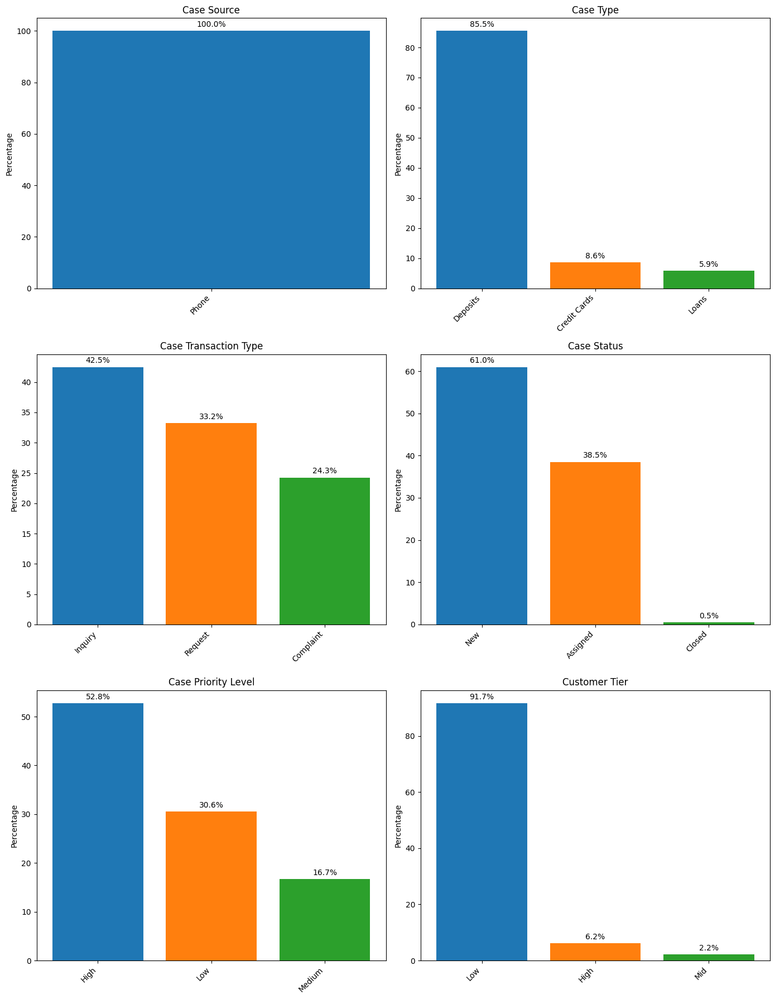

In [68]:
cols = [
    'case_source',
    'case_type',
    'case_transaction_type',
    'case_status',
    'case_priority_level',
    'customer_tier'
]

fig, axes = plt.subplots(3, 2, figsize=(14, 18))
axes = axes.flatten()

# Use the 'tab10' colormap for distinct bar colors
palette = plt.cm.tab10.colors  # 10-color palette :contentReference[oaicite:2]{index=2}

for i, col in enumerate(cols):
    # Calculate percentages
    pct = final_df[col].value_counts(normalize=True) * 100
    categories = pct.index.tolist()
    values = pct.values

    # Select one color per category
    colors = palette[:len(values)]

    # Draw bar chart
    bars = axes[i].bar(categories, values, color=colors)

    # Annotate each bar with its percentage
    axes[i].bar_label(bars, fmt='%.1f%%', padding=3)

    # Fix tick positions, then set tick labels
    axes[i].set_xticks(np.arange(len(categories)))     # fix positions :contentReference[oaicite:3]{index=3}
    axes[i].set_xticklabels(categories, rotation=45, ha='right')  # then label them :contentReference[oaicite:4]{index=4}

    # Titles and labels
    axes[i].set_title(col.replace("_", " ").title())
    axes[i].set_ylabel("Percentage")

plt.tight_layout()
plt.show()

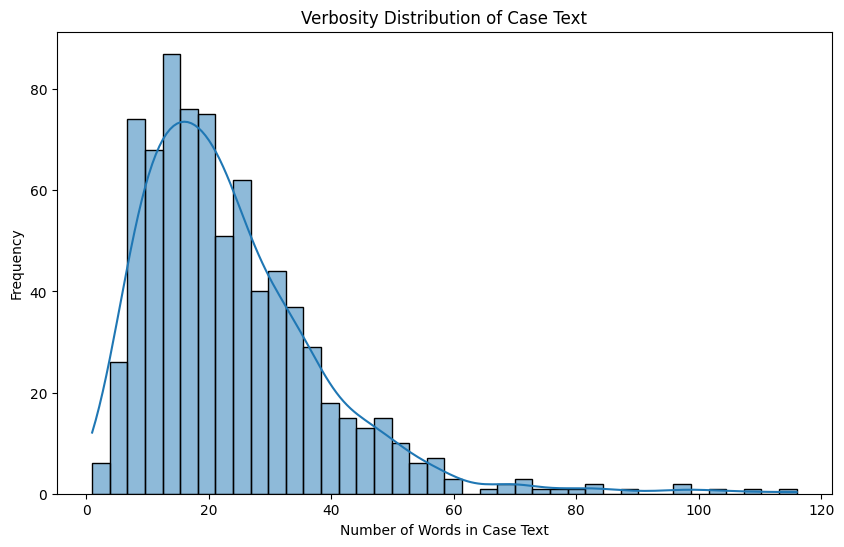

In [ ]:
# Prepare a "verbosity" metric: number of words in each case_text (joining lists with ' | ')
def get_verbosity(text):
    if isinstance(text, list):
        joined = ' | '.join(text)
    else:
        joined = str(text)
    return len(joined.split())

verbosity = final_df['case_text'].apply(get_verbosity)

plt.figure(figsize=(10, 6))
sns.histplot(verbosity, bins=40, kde=True) # type: ignore
plt.xlabel('Number of Words in Case Text')
plt.ylabel('Frequency')
plt.title('Verbosity Distribution of Case Text')
plt.show()

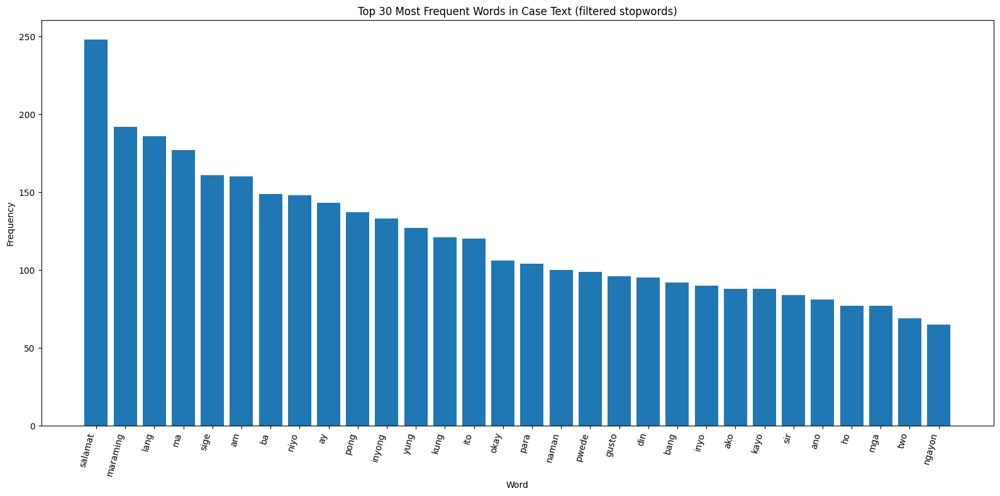

In [ ]:
# Join all case_text entries into a single string (joining lists if needed)
all_text = final_df['case_text'].apply(lambda x: ' '.join(x) if isinstance(x, list) else str(x)).str.cat(sep=' ')

# Tokenize: split on whitespace, remove punctuation, lowercase
words = re.findall(r'\b\w+\b', all_text.lower())

# Define common stopwords to exclude
stopwords = {
    'i', 'and', 'to', 'the', 'a', 'is', 'in', 'of', 'for', 'on', 'it', 'you', 
    'that', 'this', 'as', 'are', 'was', 'but', 'be', 'at', 'or', 'not', 'my',
    'with', 'have', 'has', 'had', 'from', 'they', 'he', 'she', 'we', 'their',
    'them', 'our', 'us', 'your', 'yours', 'its', 'an', 'by', 'so', 'if', 'then', 
    
    'chatbot', 'm', 's', 'ng', 'sa', 'ko', 'po', 't', 'na', 'ang',
    'eng_end', 'eng_start', 'filler', 'n_s'
}

# Filter out stopwords
filtered_words = [w for w in words if w not in stopwords]

# Count word frequencies
word_counts = Counter(filtered_words)
top10 = word_counts.most_common(30)

# Prepare for plotting
words, counts = zip(*top10)

plt.figure(figsize=(16, 8))
plt.bar(words, counts)
plt.xticks(rotation=75, ha='right')
plt.xlabel('Word')
plt.ylabel('Frequency')
plt.title('Top 30 Most Frequent Words in Case Text (filtered stopwords)')
plt.tight_layout()
plt.show()